## Getting the necessary libraries and inserting the data into a dataframe

In [1]:
import pandas as pd
import numpy as np
import matplotlib as plt
import matplotlib.pyplot as plt
import seaborn as sns
import random as rnd
from scipy.stats import zscore
from decimal import Decimal

In [2]:
data = pd.read_csv("data.csv")

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)

pd.set_option('display.float_format', lambda x: '%8f' % x)

## An initial view at the data

In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38472 entries, 0 to 38471
Data columns (total 15 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Entity                           38472 non-null  object 
 1   Continent                        38472 non-null  object 
 2   Latitude                         38472 non-null  float64
 3   Longitude                        38472 non-null  float64
 4   Average temperature per year     38472 non-null  int64  
 5   Hospital beds per 1000 people    38472 non-null  float64
 6   Medical doctors per 1000 people  38472 non-null  float64
 7   GDP/Capita                       38472 non-null  float64
 8   Population                       38472 non-null  int64  
 9   Median age                       38472 non-null  int64  
 10  Population aged 65 and over (%)  38472 non-null  int64  
 11  Date                             38472 non-null  object 
 12  Daily tests       

### See the first and last instances of the dataframe

In [4]:
data.head(5)

,Entity,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Date,Daily tests,Cases,Deaths
0,Albania,Europe,41.150000,20.170000,14,2.890000,1.290000,5353.200000,2873457,38,14,2020-02-25,8.000000,NaN,NaN
1,Albania,Europe,41.150000,20.170000,14,2.890000,1.290000,5353.200000,2873457,38,14,2020-02-26,5.000000,NaN,NaN
2,Albania,Europe,41.150000,20.170000,14,2.890000,1.290000,5353.200000,2873457,38,14,2020-02-27,4.000000,NaN,NaN
3,Albania,Europe,41.150000,20.170000,14,2.890000,1.290000,5353.200000,2873457,38,14,2020-02-28,1.000000,NaN,NaN
4,Albania,Europe,41.150000,20.170000,14,2.890000,1.290000,5353.200000,2873457,38,14,2020-02-29,8.000000,NaN,NaN


In [5]:
data.tail(5)

,Entity,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Date,Daily tests,Cases,Deaths
38467,Zimbabwe,Africa,-19.020000,29.150000,20,1.700000,0.080000,1464.000000,16529904,19,3,2021-02-24,1804.000000,35960.000000,1456.000000
38468,Zimbabwe,Africa,-19.020000,29.150000,20,1.700000,0.080000,1464.000000,16529904,19,3,2021-02-25,2965.000000,35994.000000,1458.000000
38469,Zimbabwe,Africa,-19.020000,29.150000,20,1.700000,0.080000,1464.000000,16529904,19,3,2021-02-26,NaN,36044.000000,1463.000000
38470,Zimbabwe,Africa,-19.020000,29.150000,20,1.700000,0.080000,1464.000000,16529904,19,3,2021-02-27,NaN,36058.000000,1463.000000
38471,Zimbabwe,Africa,-19.020000,29.150000,20,1.700000,0.080000,1464.000000,16529904,19,3,2021-02-28,NaN,36089.000000,1463.000000


### Check the data for a random country

In [6]:
print(data.loc[data['Entity']==np.random.choice(data['Entity'])])

       Entity Continent  Latitude  Longitude  Average temperature per year  \
32472  Sweden    Europe 60.130000  18.640000                             4   
32473  Sweden    Europe 60.130000  18.640000                             4   
32474  Sweden    Europe 60.130000  18.640000                             4   
32475  Sweden    Europe 60.130000  18.640000                             4   
32476  Sweden    Europe 60.130000  18.640000                             4   
32477  Sweden    Europe 60.130000  18.640000                             4   
32478  Sweden    Europe 60.130000  18.640000                             4   
32479  Sweden    Europe 60.130000  18.640000                             4   
32480  Sweden    Europe 60.130000  18.640000                             4   
32481  Sweden    Europe 60.130000  18.640000                             4   
32482  Sweden    Europe 60.130000  18.640000                             4   
32483  Sweden    Europe 60.130000  18.640000                    

# Data preparation, visualization and association

## Check the empty values

In [7]:
data.isnull().sum(axis = 0)

Entity                                0
Continent                             0
Latitude                              0
Longitude                             0
Average temperature per year          0
Hospital beds per 1000 people         0
Medical doctors per 1000 people       0
GDP/Capita                            0
Population                            0
Median age                            0
Population aged 65 and over (%)       0
Date                                  0
Daily tests                        7895
Cases                               254
Deaths                             3610
dtype: int64

## Change the dataframes to be easier to handle

We will divide the information for each country based of the columns that stay the same for every instance of each country and those that change based of each day. With a quick glipse. We can see that only Date,Daily tests,Cases and Deaths have different values for the same country

#### We have noticed that for every country, most columns has the same information, so we chose to reduce them into an new dataframe with each country having only one index with all the information gathered

In [8]:


countries_stats= data.drop_duplicates(ignore_index=True, subset=['Entity', 'Average temperature per year', 'Hospital beds per 1000 people',
       'Medical doctors per 1000 people', 'GDP/Capita', 'Population',
       'Median age', 'Population aged 65 and over (%)'])

countries_stats=countries_stats.drop(['Date', 'Daily tests','Cases', 'Deaths'],axis=1)
#We change the name Entity to Country, to express better its identity
countries_stats=countries_stats.rename(columns={"Entity":"Country"})
#We change the index from numeric index to Country,as it is the distinct information of each row
countries_stats.set_index('Country',inplace=True)


## Initial showcase of the data using box plots

We will use box to see the distribution of the constant values we have 

<Axes: >

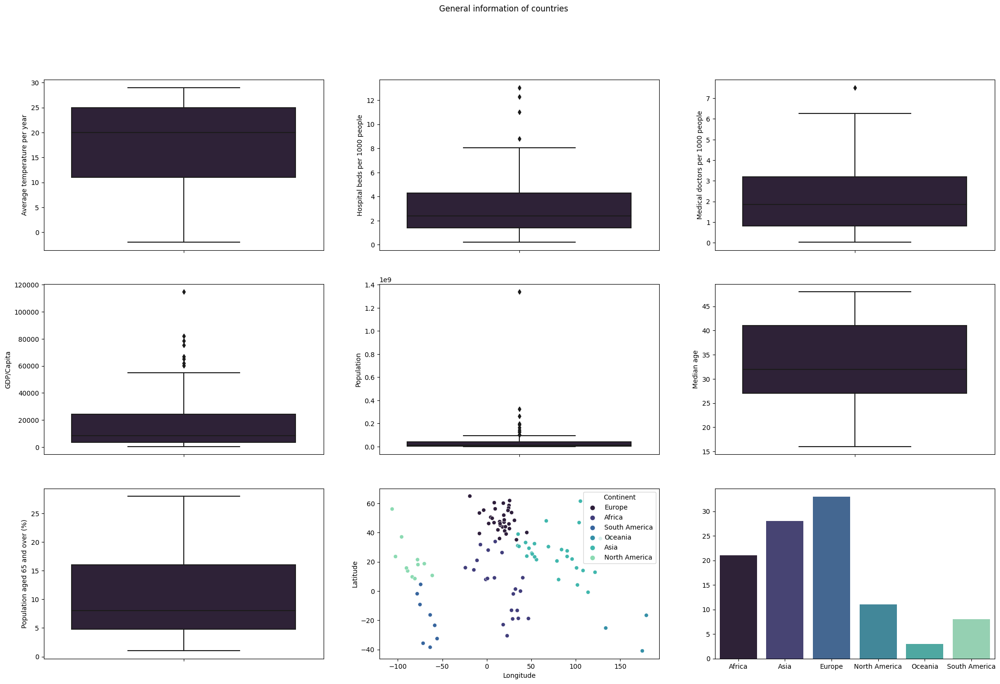

In [9]:

sns.set_palette("mako")

fig, axs = plt.subplots(3, 3 ,figsize=(25.7,15.77))
column=['Average temperature per year',
          'Hospital beds per 1000 people',
          'Medical doctors per 1000 people',
          'GDP/Capita',
          'Population',
          'Median age',
          'Population aged 65 and over (%)',
          'Longitude',
          'Latitude',
          'Continent'
          ]
fig.suptitle("General information of countries")          
sns.boxplot(data=countries_stats,y=column[0],ax=axs[0,0])
sns.boxplot(data=countries_stats,y=column[1],ax=axs[0,1])
sns.boxplot(data=countries_stats,y=column[2],ax=axs[0,2])
sns.boxplot(data=countries_stats,y=column[3],ax=axs[1,0])  
sns.boxplot(data=countries_stats,y=column[4],ax=axs[1,1])
sns.boxplot(data=countries_stats,y=column[5],ax=axs[1,2])
sns.boxplot(data=countries_stats,y=column[6],ax=axs[2,0])      
sns.scatterplot(data=countries_stats,x=column[7],y=column[8],hue=column[9],ax=axs[2,1])  

continents, cnt = np.unique(countries_stats[column[9]], return_counts=True)

sns.barplot(x=continents,y=cnt,ax=axs[2,2])   


In [10]:
print(countries_stats.describe())

        Latitude   Longitude  Average temperature per year  \
count 104.000000  104.000000                    104.000000   
mean   23.391827   19.736538                     17.807692   
std    26.223126   60.879512                      8.128909   
min   -40.900000 -106.350000                     -2.000000   
25%     8.600000   -4.352500                     11.000000   
50%    26.925000   21.415000                     20.000000   
75%    45.310000   47.022500                     25.000000   
max    64.960000  179.410000                     29.000000   

       Hospital beds per 1000 people  Medical doctors per 1000 people  \
count                     104.000000                       104.000000   
mean                        3.137308                         2.066827   
std                         2.549268                         1.534378   
min                         0.200000                         0.020000   
25%                         1.395000                         0.812500   
50%

## Creation of statistical metrics related directly to covid

In [11]:
#We create a dictionary of dataframes for each country
data_days_stats={}
for country in countries_stats.index:
    single_country=data.loc[data['Entity']==country]
    single_country=single_country[['Date','Daily tests','Cases','Deaths']]
    #The data at data_days_stats are in reality a time series for each day, so it is the best to use Date as an index
    single_country=single_country.set_index("Date")
    data_days_stats[country]=  single_country

In [12]:
def check_countries():   
    print('Check the daily tests cases and deaths of each country for each day')
    for country,country_day_info in data_days_stats.items():
        print('Info for ',country)
        print(country_day_info)
check_countries()

Check the daily tests cases and deaths of each country for each day
Info for  Albania
            Daily tests         Cases      Deaths
Date                                             
2020-02-25     8.000000           NaN         NaN
2020-02-26     5.000000           NaN         NaN
2020-02-27     4.000000           NaN         NaN
2020-02-28     1.000000           NaN         NaN
2020-02-29     8.000000           NaN         NaN
2020-03-01     3.000000           NaN         NaN
2020-03-02     2.000000           NaN         NaN
2020-03-03     5.000000           NaN         NaN
2020-03-04     6.000000           NaN         NaN
2020-03-05     8.000000           NaN         NaN
2020-03-06     3.000000           NaN         NaN
2020-03-07     5.000000           NaN         NaN
2020-03-08     1.000000           NaN         NaN
2020-03-09    18.000000      2.000000         NaN
2020-03-10    37.000000     10.000000         NaN
2020-03-11    43.000000     12.000000    1.000000
2020-03-12   1

We can see that for all the rows that have null values at Cases and Deaths columns, it is at the start no-one has died yet or the country has started covid testing without any positive result.So in those situcolumns, we will fill the empty values with 0

We will calculate the daily cases and deaths based of the difference in the numbers from the previous day. We will need to fill the first row with 0,as the diff causes the first row to have NaN

In [13]:

for country in data_days_stats.values():
    country['Cases']=country['Cases'].fillna(0)
    country['Deaths']=country['Deaths'].fillna(0)
    country["Daily cases"]=country['Cases'].diff(1)                                                           
    country["Daily deaths"]=country['Deaths'].diff(1)
    country['Daily cases']=country['Daily cases'].fillna(country['Cases'])
    country['Daily deaths']=country['Daily deaths'].fillna(country['Cases'])

   

For the tests, there a lot of NaN values for a decent amount of countries in places other than the start of the dataframe.We could use linear interpolation to fill the empty values,but because we cannot be sure for the numbers of tests and we run to the risk to increase the tests artificially without reason. We will take as a given that for every covid case,a covid test has been used to spot the illness.If a number of tests exists but it is less than the covid cases, we will replace the number of tests with the number of cases.

In [14]:
def set_Daily_tests(row):
    if row['Daily tests']<row['Daily cases']:
        return row['Daily cases']
    else:
        return row['Daily tests']

for country in data_days_stats.values():
    country['Daily tests']=country['Daily tests'].fillna(country['Daily cases'])
    country['Daily tests']=country.apply(set_Daily_tests, axis = 1)
check_countries()    

Check the daily tests cases and deaths of each country for each day
Info for  Albania
            Daily tests         Cases      Deaths  Daily cases  Daily deaths
Date                                                                        
2020-02-25     8.000000      0.000000    0.000000     0.000000      0.000000
2020-02-26     5.000000      0.000000    0.000000     0.000000      0.000000
2020-02-27     4.000000      0.000000    0.000000     0.000000      0.000000
2020-02-28     1.000000      0.000000    0.000000     0.000000      0.000000
2020-02-29     8.000000      0.000000    0.000000     0.000000      0.000000
2020-03-01     3.000000      0.000000    0.000000     0.000000      0.000000
2020-03-02     2.000000      0.000000    0.000000     0.000000      0.000000
2020-03-03     5.000000      0.000000    0.000000     0.000000      0.000000
2020-03-04     6.000000      0.000000    0.000000     0.000000      0.000000
2020-03-05     8.000000      0.000000    0.000000     0.000000     

Daily positivity (%) is the daily percentage of covid cases to covid cases. 

In [15]:
def set_Daily_tests_positivity(row):
    if row['Daily cases']==0:
        return 0
    else:
        return row['Daily cases']/row['Daily tests']
for country in data_days_stats.values():
    country['Daily tests positivity (%)']=country.apply(set_Daily_tests_positivity,axis=1)

In [16]:
for country,dataframes in data_days_stats.items():    
     print("Numeric information for each column for ",country)
     print(country,data_days_stats[country].describe())
    

Numeric information for each column for  Albania
Albania        Daily tests         Cases      Deaths  Daily cases  Daily deaths  \
count   370.000000    370.000000  370.000000   370.000000    370.000000   
mean   1183.202703  22774.275676  464.572973   289.640541      4.854054   
std    1190.368304  29178.287865  514.300347   334.345971      5.134537   
min       1.000000      0.000000    0.000000     0.000000      0.000000   
25%     259.000000   1056.500000   33.000000    23.000000      1.000000   
50%     814.500000   9139.000000  268.500000   132.500000      3.500000   
75%    1903.250000  36653.750000  783.000000   536.500000      7.000000   
max    4562.000000 107167.000000 1796.000000  1239.000000     21.000000   

       Daily tests positivity (%)  
count                  370.000000  
mean                     0.199110  
std                      0.146635  
min                      0.000000  
25%                      0.128316  
50%                      0.187991  
75%            

In [17]:
check_countries()    

Check the daily tests cases and deaths of each country for each day
Info for  Albania
            Daily tests         Cases      Deaths  Daily cases  Daily deaths  \
Date                                                                           
2020-02-25     8.000000      0.000000    0.000000     0.000000      0.000000   
2020-02-26     5.000000      0.000000    0.000000     0.000000      0.000000   
2020-02-27     4.000000      0.000000    0.000000     0.000000      0.000000   
2020-02-28     1.000000      0.000000    0.000000     0.000000      0.000000   
2020-02-29     8.000000      0.000000    0.000000     0.000000      0.000000   
2020-03-01     3.000000      0.000000    0.000000     0.000000      0.000000   
2020-03-02     2.000000      0.000000    0.000000     0.000000      0.000000   
2020-03-03     5.000000      0.000000    0.000000     0.000000      0.000000   
2020-03-04     6.000000      0.000000    0.000000     0.000000      0.000000   
2020-03-05     8.000000      0.000

[Text(0.5, 1.0, 'Israel')]

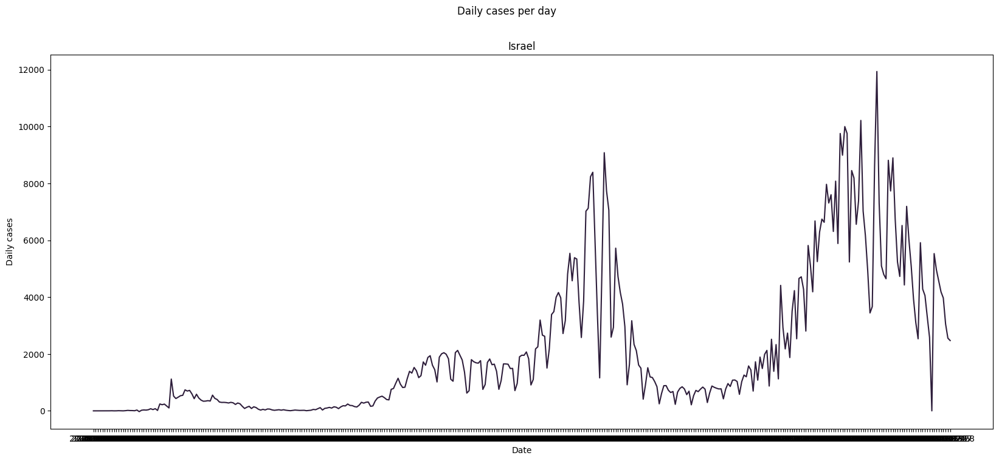

In [18]:
fig, axes = plt.subplots(figsize=(20, 8) )
fig.suptitle("Daily cases per day")
country,dataframes = rnd.choice(list(data_days_stats.items()))
sns.lineplot(data=dataframes,x=dataframes.index,y='Daily cases').set(title=country)


In [19]:
for country in data_days_stats:   
    print(data_days_stats[country].head(50))
    print(data_days_stats[country].tail(20))

            Daily tests      Cases    Deaths  Daily cases  Daily deaths  \
Date                                                                      
2020-02-25     8.000000   0.000000  0.000000     0.000000      0.000000   
2020-02-26     5.000000   0.000000  0.000000     0.000000      0.000000   
2020-02-27     4.000000   0.000000  0.000000     0.000000      0.000000   
2020-02-28     1.000000   0.000000  0.000000     0.000000      0.000000   
2020-02-29     8.000000   0.000000  0.000000     0.000000      0.000000   
2020-03-01     3.000000   0.000000  0.000000     0.000000      0.000000   
2020-03-02     2.000000   0.000000  0.000000     0.000000      0.000000   
2020-03-03     5.000000   0.000000  0.000000     0.000000      0.000000   
2020-03-04     6.000000   0.000000  0.000000     0.000000      0.000000   
2020-03-05     8.000000   0.000000  0.000000     0.000000      0.000000   
2020-03-06     3.000000   0.000000  0.000000     0.000000      0.000000   
2020-03-07     5.000000  

We take the mean daily deaths and cases after 10 total cases, as a way to cut the first days that they are records of either tests or cases but covid hadn't really started to spread

In [20]:
mean_daily_tests=[]
mean_daily_cases=[]
mean_daily_positivity_tests=[]
mean_daily_deaths=[]

for dataframes in data_days_stats.values():
    mean_daily_tests.append(dataframes["Daily tests"].mean())
    mean_daily_positivity_tests.append(dataframes['Daily tests positivity (%)'].mean())
    mean_daily_cases.append(dataframes['Daily cases'].loc[dataframes["Cases"]>10].mean())
    mean_daily_deaths.append(dataframes['Daily deaths'].loc[dataframes["Cases"]>10].mean())   
                                                      

In [21]:
countries_stats['Mean daily tests']=mean_daily_tests
countries_stats['Mean positivity tests (%)']=mean_daily_positivity_tests
countries_stats['Mean daily cases']=mean_daily_cases
countries_stats['Mean daily deaths']=mean_daily_deaths



In [22]:
countries_stats.sample(20).head(10)

,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths
Country,,,,,,,,,,,,,,
Iran,Asia,32.430000,53.690000,20,1.500000,1.490000,5550.100000,81162788,32,6,16043.960106,0.592844,4361.401070,160.617647
Bahrain,Asia,25.930000,50.640000,27,2.000000,0.920000,23504.000000,1492584,32,2,7015.123989,0.265136,330.791892,1.213514
United Kingdom,Europe,55.380000,-3.440000,8,2.540000,2.820000,42330.100000,66022273,40,18,211175.767089,0.184978,10823.819121,318.043928
India,Asia,20.590000,78.960000,25,0.530000,0.760000,2099.600000,1339180127,28,6,517420.184343,0.163706,30696.784530,434.135359
Serbia,Europe,44.020000,21.010000,12,5.610000,2.460000,7411.800000,7022268,41,18,7905.422343,0.132828,1293.673239,12.515493
Slovakia,Europe,48.670000,19.700000,9,5.820000,3.450000,19266.300000,5439892,41,16,39677.561111,0.058319,870.262712,20.307910
Nepal,Asia,28.390000,84.120000,15,0.300000,0.600000,1071.100000,29304998,25,6,5291.503741,0.100043,848.712074,8.588235
Iraq,Asia,33.220000,43.680000,24,1.400000,0.850000,5955.100000,38274618,20,3,14113.469003,0.367623,1900.224044,36.628415
Belgium,Europe,50.500000,4.470000,10,5.640000,3.010000,46420.700000,11372068,41,19,23921.132992,0.084578,2125.352617,60.818182


In [23]:
countries_stats['Mean daily tests']=countries_stats['Mean daily tests'].apply(lambda  x:round(x))
countries_stats['Mean daily cases']=countries_stats['Mean daily cases'].apply(lambda  x:round(x))

In [24]:
countries_stats.head(10)

,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths
Country,,,,,,,,,,,,,,
Albania,Europe,41.150000,20.170000,14,2.890000,1.290000,5353.200000,2873457,38,14,1183,0.199110,302,5.059155
Algeria,Africa,28.030000,1.660000,25,1.900000,1.830000,3974.000000,41318142,29,6,313,0.967895,312,8.240331
Argentina,South America,-38.420000,-63.620000,14,5.000000,3.910000,9912.300000,44271041,31,11,15214,0.275673,5886,145.153631
Armenia,Europe,40.070000,45.040000,11,4.200000,2.800000,4622.700000,2930450,35,11,713,0.846233,489,9.068182
Australia,Oceania,-25.270000,133.780000,22,3.840000,3.500000,55060.300000,24598933,37,16,23366,0.368665,74,2.307107
Austria,Europe,47.520000,14.550000,8,7.370000,5.230000,50137.700000,8809212,44,19,38621,0.155932,1259,23.454795
Bahrain,Asia,25.930000,50.640000,27,2.000000,0.920000,23504.000000,1492584,32,2,7015,0.265136,331,1.213514
Bangladesh,Asia,23.680000,90.360000,25,0.800000,0.470000,1855.700000,164669751,27,5,11056,0.136186,1570,24.160920
Belarus,Europe,53.710000,27.950000,8,11.000000,4.070000,6663.300000,9507875,40,15,1992,0.810738,812,5.581921


In [25]:
total_tests=[]
for dataframe in data_days_stats.values():
    total_tests.append(dataframe['Daily tests'].sum())
countries_stats['Total tests']= total_tests    

total_cases=[]
for dataframe in data_days_stats.values():
    total_cases.append(dataframe.loc['2021-02-28','Cases'])
countries_stats['Total cases']= total_cases  

total_deaths=[]
for dataframe in data_days_stats.values():
   
    total_deaths.append(dataframe.loc['2021-02-28','Deaths'])
    

countries_stats['Total deaths']= total_deaths 

In [26]:

    

countries_stats['Total tests per total population percentage (%)']=(countries_stats['Total tests']/countries_stats['Population'])*100


In [27]:



countries_stats['Covid cases per total population percentage (%)']=(countries_stats['Total cases']/countries_stats['Population'])*100




In [28]:
 
countries_stats['Total deaths per total population percentage (%)']=(countries_stats['Total deaths']/countries_stats['Population'])*100

countries_stats['Covid mortality (%)']=(countries_stats['Total deaths']/countries_stats['Total cases'])*100

In [29]:
countries_stats['Mean daily tests per ten thousand people of population']=(countries_stats['Mean daily tests']/countries_stats['Population'])*10000


countries_stats['Mean daily cases per ten thousand people of population']=(countries_stats['Mean daily cases']/countries_stats['Population'])*10000


 
countries_stats['Mean daily deaths per ten thousand people of population']=(countries_stats['Mean daily deaths']/countries_stats['Population'])*10000


countries_stats['Covid mortality per ten thousand people']=(countries_stats['Total deaths']/countries_stats['Total cases'])*10000


In [30]:
Covid_Mortality_Increase=[]
for country,dataframe in data_days_stats.items():
 
    country_data=countries_stats.loc[country]
    intensive_days=dataframe.loc[dataframe['Daily cases']>country_data['Mean daily cases']]
    mean_intensive=(intensive_days['Daily deaths'].sum()/intensive_days['Daily cases'].sum())*100
    Covid_Mortality_Increase.append(country_data['Covid mortality (%)'] -mean_intensive)
countries_stats['Covid mortality (%) increase in intensive days'] = Covid_Mortality_Increase

In [31]:
pd.set_option('display.max_rows', 365)
pd.set_option('display.max_columns', 365)


## Review of all the metrics

We can see from the below sorted dataframes, that even though per total population percentage and mean daily per ten thousand people of population have different origins (total vs mean per day),they end up expressing the same scale of information (the amount of tests,cases and deaths relative to their population) and the countries have almost the same positions in both columns

In [32]:
sorting_column='Total tests per total population percentage (%)'
countries_stats.sort_values(by=sorting_column,ascending=1)

,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests,Total cases,Total deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Mean daily tests per ten thousand people of population,Mean daily cases per ten thousand people of population,Mean daily deaths per ten thousand people of population,Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days
Country,,,,,,,,,,,,,,,,,,,,,,,,,,
Madagascar,Africa,-18.770000,46.870000,22,0.200000,0.140000,523.400000,25570895,19,3,125,0.446381,58,0.865889,43154.000000,19831.000000,297.000000,0.168762,0.077553,0.001161,1.497655,0.048884,0.022682,0.000339,149.765519,0.089778
Algeria,Africa,28.030000,1.660000,25,1.900000,1.830000,3974.000000,41318142,29,6,313,0.967895,312,8.240331,115673.000000,113092.000000,2983.000000,0.279957,0.273710,0.007220,2.637676,0.075754,0.075512,0.001994,263.767552,0.712304
Vietnam,Asia,14.060000,108.280000,25,2.600000,0.820000,2715.300000,95540800,32,7,834,0.610575,6,0.090439,335913.000000,2448.000000,35.000000,0.351591,0.002562,0.000037,1.429739,0.087293,0.000628,0.000009,142.973856,0.276856
Nigeria,Africa,9.080000,8.680000,28,0.500000,0.400000,2229.900000,190886311,18,3,2116,0.576296,450,5.511561,776492.000000,155657.000000,1907.000000,0.406782,0.081544,0.000999,1.225130,0.110851,0.023574,0.000289,122.512961,0.182052
Malawi,Africa,-13.250000,34.300000,21,1.300000,0.020000,411.600000,18622104,18,3,250,0.442995,99,3.219136,83602.000000,31945.000000,1044.000000,0.448940,0.171543,0.005606,3.268117,0.134249,0.053163,0.001729,326.811708,-0.051504
Mauritania,Africa,21.010000,-10.940000,29,0.400000,0.070000,1679.400000,4420184,20,3,109,0.709491,59,1.506849,38508.000000,17207.000000,441.000000,0.871185,0.389282,0.009977,2.562910,0.246596,0.133479,0.003409,256.291044,-0.099010
Kenya,Africa,-0.020000,37.910000,24,1.400000,0.200000,1816.500000,49699862,20,2,1797,0.513508,308,5.395349,634241.000000,105973.000000,1856.000000,1.276142,0.213226,0.003734,1.751390,0.361570,0.061972,0.001086,175.138950,0.222138
Uganda,Africa,1.370000,32.290000,24,0.500000,0.090000,794.300000,42862958,16,2,1600,0.404951,118,0.979472,552007.000000,40357.000000,334.000000,1.287842,0.094154,0.000779,0.827614,0.373283,0.027530,0.000229,82.761355,0.047451
Mozambique,Africa,-18.670000,35.530000,23,0.700000,0.060000,503.600000,29668834,17,3,1192,0.131413,181,1.960245,409947.000000,59350.000000,641.000000,1.381743,0.200042,0.002161,1.080034,0.401768,0.061007,0.000661,108.003370,-0.042336


In [33]:
sorting_column='Mean daily tests per ten thousand people of population'
countries_stats.sort_values(by=sorting_column,ascending=1)

,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests,Total cases,Total deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Mean daily tests per ten thousand people of population,Mean daily cases per ten thousand people of population,Mean daily deaths per ten thousand people of population,Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days
Country,,,,,,,,,,,,,,,,,,,,,,,,,,
Madagascar,Africa,-18.770000,46.870000,22,0.200000,0.140000,523.400000,25570895,19,3,125,0.446381,58,0.865889,43154.000000,19831.000000,297.000000,0.168762,0.077553,0.001161,1.497655,0.048884,0.022682,0.000339,149.765519,0.089778
Algeria,Africa,28.030000,1.660000,25,1.900000,1.830000,3974.000000,41318142,29,6,313,0.967895,312,8.240331,115673.000000,113092.000000,2983.000000,0.279957,0.273710,0.007220,2.637676,0.075754,0.075512,0.001994,263.767552,0.712304
Vietnam,Asia,14.060000,108.280000,25,2.600000,0.820000,2715.300000,95540800,32,7,834,0.610575,6,0.090439,335913.000000,2448.000000,35.000000,0.351591,0.002562,0.000037,1.429739,0.087293,0.000628,0.000009,142.973856,0.276856
Nigeria,Africa,9.080000,8.680000,28,0.500000,0.400000,2229.900000,190886311,18,3,2116,0.576296,450,5.511561,776492.000000,155657.000000,1907.000000,0.406782,0.081544,0.000999,1.225130,0.110851,0.023574,0.000289,122.512961,0.182052
Malawi,Africa,-13.250000,34.300000,21,1.300000,0.020000,411.600000,18622104,18,3,250,0.442995,99,3.219136,83602.000000,31945.000000,1044.000000,0.448940,0.171543,0.005606,3.268117,0.134249,0.053163,0.001729,326.811708,-0.051504
Mauritania,Africa,21.010000,-10.940000,29,0.400000,0.070000,1679.400000,4420184,20,3,109,0.709491,59,1.506849,38508.000000,17207.000000,441.000000,0.871185,0.389282,0.009977,2.562910,0.246596,0.133479,0.003409,256.291044,-0.099010
Kenya,Africa,-0.020000,37.910000,24,1.400000,0.200000,1816.500000,49699862,20,2,1797,0.513508,308,5.395349,634241.000000,105973.000000,1856.000000,1.276142,0.213226,0.003734,1.751390,0.361570,0.061972,0.001086,175.138950,0.222138
Uganda,Africa,1.370000,32.290000,24,0.500000,0.090000,794.300000,42862958,16,2,1600,0.404951,118,0.979472,552007.000000,40357.000000,334.000000,1.287842,0.094154,0.000779,0.827614,0.373283,0.027530,0.000229,82.761355,0.047451
Mozambique,Africa,-18.670000,35.530000,23,0.700000,0.060000,503.600000,29668834,17,3,1192,0.131413,181,1.960245,409947.000000,59350.000000,641.000000,1.381743,0.200042,0.002161,1.080034,0.401768,0.061007,0.000661,108.003370,-0.042336


In [34]:
sorting_column='Covid cases per total population percentage (%)'
countries_stats.sort_values(by=sorting_column,ascending=1)

,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests,Total cases,Total deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Mean daily tests per ten thousand people of population,Mean daily cases per ten thousand people of population,Mean daily deaths per ten thousand people of population,Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days
Country,,,,,,,,,,,,,,,,,,,,,,,,,,
Vietnam,Asia,14.060000,108.280000,25,2.600000,0.820000,2715.300000,95540800,32,7,834,0.610575,6,0.090439,335913.000000,2448.000000,35.000000,0.351591,0.002562,0.000037,1.429739,0.087293,0.000628,0.000009,142.973856,0.276856
Fiji,Oceania,-16.580000,179.410000,25,2.300000,0.840000,6175.900000,905502,28,5,69,0.030990,0,0.006042,24409.000000,59.000000,2.000000,2.695632,0.006516,0.000221,3.389831,0.762008,0.000000,0.000067,338.983051,3.389831
Thailand,Asia,15.870000,100.990000,27,2.100000,0.470000,7806.700000,69037513,40,12,6371,0.020131,65,0.208543,2682092.000000,26031.000000,83.000000,3.884978,0.037706,0.000120,0.318851,0.922832,0.009415,0.000030,31.885060,0.118919
New Zealand,Oceania,-40.900000,174.890000,11,2.610000,3.060000,42084.400000,4793900,37,16,4005,0.106173,7,0.074499,1469686.000000,2378.000000,26.000000,30.657419,0.049605,0.000542,1.093356,8.354367,0.014602,0.000155,109.335576,0.425204
Madagascar,Africa,-18.770000,46.870000,22,0.200000,0.140000,523.400000,25570895,19,3,125,0.446381,58,0.865889,43154.000000,19831.000000,297.000000,0.168762,0.077553,0.001161,1.497655,0.048884,0.022682,0.000339,149.765519,0.089778
Nigeria,Africa,9.080000,8.680000,28,0.500000,0.400000,2229.900000,190886311,18,3,2116,0.576296,450,5.511561,776492.000000,155657.000000,1907.000000,0.406782,0.081544,0.000999,1.225130,0.110851,0.023574,0.000289,122.512961,0.182052
Togo,Africa,8.620000,0.820000,27,0.700000,0.050000,679.300000,7797694,19,3,647,0.038102,20,0.243478,234051.000000,6901.000000,84.000000,3.001541,0.088501,0.001077,1.217215,0.829732,0.025649,0.000312,121.721490,0.656234
Uganda,Africa,1.370000,32.290000,24,0.500000,0.090000,794.300000,42862958,16,2,1600,0.404951,118,0.979472,552007.000000,40357.000000,334.000000,1.287842,0.094154,0.000779,0.827614,0.373283,0.027530,0.000229,82.761355,0.047451
Mongolia,Asia,46.860000,103.850000,2,7.000000,3.260000,4339.800000,3075647,28,4,4523,0.267744,9,0.005882,1610150.000000,2952.000000,2.000000,52.351587,0.095980,0.000065,0.067751,14.705849,0.029262,0.000019,6.775068,-0.007437


In [35]:
sorting_column='Mean daily cases per ten thousand people of population'
countries_stats.sort_values(by=sorting_column,ascending=1)

,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests,Total cases,Total deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Mean daily tests per ten thousand people of population,Mean daily cases per ten thousand people of population,Mean daily deaths per ten thousand people of population,Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days
Country,,,,,,,,,,,,,,,,,,,,,,,,,,
Fiji,Oceania,-16.580000,179.410000,25,2.300000,0.840000,6175.900000,905502,28,5,69,0.030990,0,0.006042,24409.000000,59.000000,2.000000,2.695632,0.006516,0.000221,3.389831,0.762008,0.000000,0.000067,338.983051,3.389831
Vietnam,Asia,14.060000,108.280000,25,2.600000,0.820000,2715.300000,95540800,32,7,834,0.610575,6,0.090439,335913.000000,2448.000000,35.000000,0.351591,0.002562,0.000037,1.429739,0.087293,0.000628,0.000009,142.973856,0.276856
Thailand,Asia,15.870000,100.990000,27,2.100000,0.470000,7806.700000,69037513,40,12,6371,0.020131,65,0.208543,2682092.000000,26031.000000,83.000000,3.884978,0.037706,0.000120,0.318851,0.922832,0.009415,0.000030,31.885060,0.118919
New Zealand,Oceania,-40.900000,174.890000,11,2.610000,3.060000,42084.400000,4793900,37,16,4005,0.106173,7,0.074499,1469686.000000,2378.000000,26.000000,30.657419,0.049605,0.000542,1.093356,8.354367,0.014602,0.000155,109.335576,0.425204
Madagascar,Africa,-18.770000,46.870000,22,0.200000,0.140000,523.400000,25570895,19,3,125,0.446381,58,0.865889,43154.000000,19831.000000,297.000000,0.168762,0.077553,0.001161,1.497655,0.048884,0.022682,0.000339,149.765519,0.089778
Nigeria,Africa,9.080000,8.680000,28,0.500000,0.400000,2229.900000,190886311,18,3,2116,0.576296,450,5.511561,776492.000000,155657.000000,1907.000000,0.406782,0.081544,0.000999,1.225130,0.110851,0.023574,0.000289,122.512961,0.182052
Togo,Africa,8.620000,0.820000,27,0.700000,0.050000,679.300000,7797694,19,3,647,0.038102,20,0.243478,234051.000000,6901.000000,84.000000,3.001541,0.088501,0.001077,1.217215,0.829732,0.025649,0.000312,121.721490,0.656234
Uganda,Africa,1.370000,32.290000,24,0.500000,0.090000,794.300000,42862958,16,2,1600,0.404951,118,0.979472,552007.000000,40357.000000,334.000000,1.287842,0.094154,0.000779,0.827614,0.373283,0.027530,0.000229,82.761355,0.047451
Mongolia,Asia,46.860000,103.850000,2,7.000000,3.260000,4339.800000,3075647,28,4,4523,0.267744,9,0.005882,1610150.000000,2952.000000,2.000000,52.351587,0.095980,0.000065,0.067751,14.705849,0.029262,0.000019,6.775068,-0.007437


In [36]:
sorting_column='Total deaths per total population percentage (%)'
countries_stats.sort_values(by=sorting_column,ascending=1)

,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests,Total cases,Total deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Mean daily tests per ten thousand people of population,Mean daily cases per ten thousand people of population,Mean daily deaths per ten thousand people of population,Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days
Country,,,,,,,,,,,,,,,,,,,,,,,,,,
Vietnam,Asia,14.060000,108.280000,25,2.600000,0.820000,2715.300000,95540800,32,7,834,0.610575,6,0.090439,335913.000000,2448.000000,35.000000,0.351591,0.002562,0.000037,1.429739,0.087293,0.000628,0.000009,142.973856,0.276856
Mongolia,Asia,46.860000,103.850000,2,7.000000,3.260000,4339.800000,3075647,28,4,4523,0.267744,9,0.005882,1610150.000000,2952.000000,2.000000,52.351587,0.095980,0.000065,0.067751,14.705849,0.029262,0.000019,6.775068,-0.007437
Thailand,Asia,15.870000,100.990000,27,2.100000,0.470000,7806.700000,69037513,40,12,6371,0.020131,65,0.208543,2682092.000000,26031.000000,83.000000,3.884978,0.037706,0.000120,0.318851,0.922832,0.009415,0.000030,31.885060,0.118919
Bhutan,Asia,27.510000,90.430000,13,1.700000,0.380000,3316.200000,807610,28,6,1411,0.044245,3,0.003413,508115.000000,867.000000,1.000000,62.915888,0.107354,0.000124,0.115340,17.471304,0.037147,0.000042,11.534025,-0.031719
Fiji,Oceania,-16.580000,179.410000,25,2.300000,0.840000,6175.900000,905502,28,5,69,0.030990,0,0.006042,24409.000000,59.000000,2.000000,2.695632,0.006516,0.000221,3.389831,0.762008,0.000000,0.000067,338.983051,3.389831
New Zealand,Oceania,-40.900000,174.890000,11,2.610000,3.060000,42084.400000,4793900,37,16,4005,0.106173,7,0.074499,1469686.000000,2378.000000,26.000000,30.657419,0.049605,0.000542,1.093356,8.354367,0.014602,0.000155,109.335576,0.425204
Uganda,Africa,1.370000,32.290000,24,0.500000,0.090000,794.300000,42862958,16,2,1600,0.404951,118,0.979472,552007.000000,40357.000000,334.000000,1.287842,0.094154,0.000779,0.827614,0.373283,0.027530,0.000229,82.761355,0.047451
Nigeria,Africa,9.080000,8.680000,28,0.500000,0.400000,2229.900000,190886311,18,3,2116,0.576296,450,5.511561,776492.000000,155657.000000,1907.000000,0.406782,0.081544,0.000999,1.225130,0.110851,0.023574,0.000289,122.512961,0.182052
Togo,Africa,8.620000,0.820000,27,0.700000,0.050000,679.300000,7797694,19,3,647,0.038102,20,0.243478,234051.000000,6901.000000,84.000000,3.001541,0.088501,0.001077,1.217215,0.829732,0.025649,0.000312,121.721490,0.656234


In [37]:
sorting_column='Mean daily deaths per ten thousand people of population'
countries_stats.sort_values(by=sorting_column,ascending=1)

,Continent,Latitude,Longitude,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests,Total cases,Total deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Mean daily tests per ten thousand people of population,Mean daily cases per ten thousand people of population,Mean daily deaths per ten thousand people of population,Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days
Country,,,,,,,,,,,,,,,,,,,,,,,,,,
Vietnam,Asia,14.060000,108.280000,25,2.600000,0.820000,2715.300000,95540800,32,7,834,0.610575,6,0.090439,335913.000000,2448.000000,35.000000,0.351591,0.002562,0.000037,1.429739,0.087293,0.000628,0.000009,142.973856,0.276856
Mongolia,Asia,46.860000,103.850000,2,7.000000,3.260000,4339.800000,3075647,28,4,4523,0.267744,9,0.005882,1610150.000000,2952.000000,2.000000,52.351587,0.095980,0.000065,0.067751,14.705849,0.029262,0.000019,6.775068,-0.007437
Thailand,Asia,15.870000,100.990000,27,2.100000,0.470000,7806.700000,69037513,40,12,6371,0.020131,65,0.208543,2682092.000000,26031.000000,83.000000,3.884978,0.037706,0.000120,0.318851,0.922832,0.009415,0.000030,31.885060,0.118919
Bhutan,Asia,27.510000,90.430000,13,1.700000,0.380000,3316.200000,807610,28,6,1411,0.044245,3,0.003413,508115.000000,867.000000,1.000000,62.915888,0.107354,0.000124,0.115340,17.471304,0.037147,0.000042,11.534025,-0.031719
Fiji,Oceania,-16.580000,179.410000,25,2.300000,0.840000,6175.900000,905502,28,5,69,0.030990,0,0.006042,24409.000000,59.000000,2.000000,2.695632,0.006516,0.000221,3.389831,0.762008,0.000000,0.000067,338.983051,3.389831
New Zealand,Oceania,-40.900000,174.890000,11,2.610000,3.060000,42084.400000,4793900,37,16,4005,0.106173,7,0.074499,1469686.000000,2378.000000,26.000000,30.657419,0.049605,0.000542,1.093356,8.354367,0.014602,0.000155,109.335576,0.425204
Uganda,Africa,1.370000,32.290000,24,0.500000,0.090000,794.300000,42862958,16,2,1600,0.404951,118,0.979472,552007.000000,40357.000000,334.000000,1.287842,0.094154,0.000779,0.827614,0.373283,0.027530,0.000229,82.761355,0.047451
Nigeria,Africa,9.080000,8.680000,28,0.500000,0.400000,2229.900000,190886311,18,3,2116,0.576296,450,5.511561,776492.000000,155657.000000,1907.000000,0.406782,0.081544,0.000999,1.225130,0.110851,0.023574,0.000289,122.512961,0.182052
Togo,Africa,8.620000,0.820000,27,0.700000,0.050000,679.300000,7797694,19,3,647,0.038102,20,0.243478,234051.000000,6901.000000,84.000000,3.001541,0.088501,0.001077,1.217215,0.829732,0.025649,0.000312,121.721490,0.656234


## Creation of plots to explore the data visually

We will use per total population percentage instead of per ten thousand people, as we can se a bit more sure that information haven't been lost from the limit of decimal digits

<Axes: ylabel='Total deaths per total population percentage (%)'>

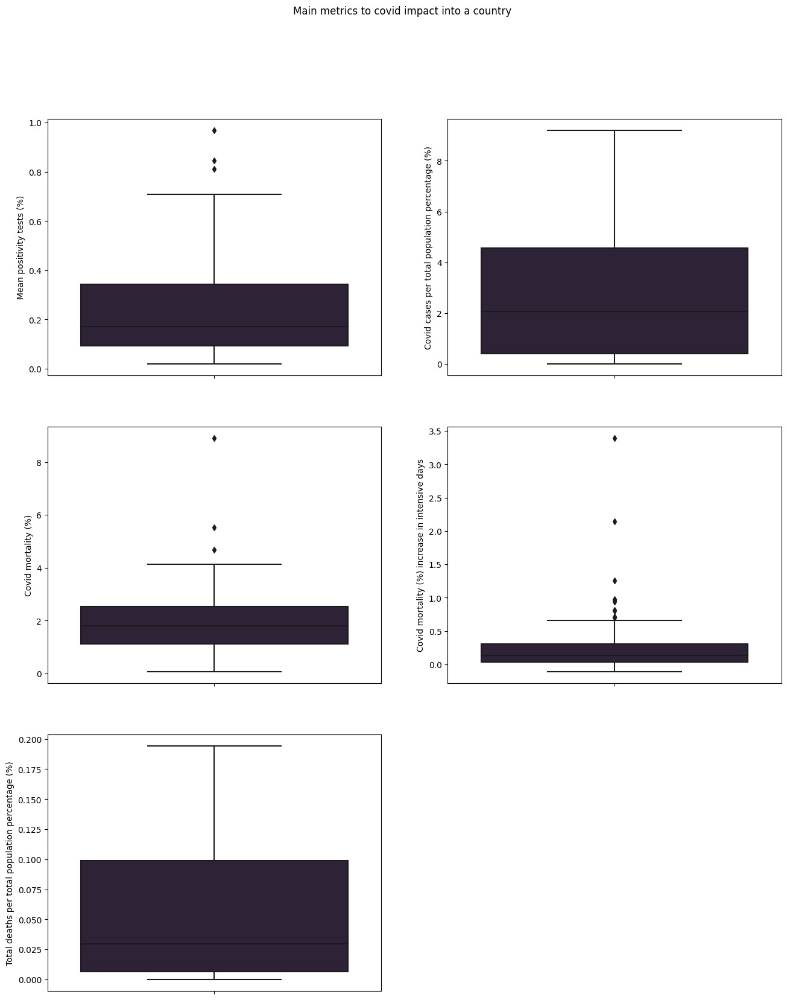

In [38]:

fig, axs = plt.subplots(3, 2 ,figsize=(15.7,18.77))
fig.suptitle('Main metrics to covid impact into a country')
column=['Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
fig.delaxes(axs[2,1])          
sns.boxplot(data=countries_stats,y=column[0],ax=axs[0,0])
sns.boxplot(data=countries_stats,y=column[1],ax=axs[0,1])
sns.boxplot(data=countries_stats,y=column[2],ax=axs[1,0])
sns.boxplot(data=countries_stats,y=column[3],ax=axs[1,1])  
sns.boxplot(data=countries_stats,y=column[4],ax=axs[2,0])  

As we see that outliers make it harder to see the majority range of the data, we will use at the graphs a function to remove them for beter visibility. We will create a temporary dataframe to not affect the main dataframe in any way

In [39]:


def remove_outlier(df, column, lower_bound=0.25,upper_bound=0.75):
    # Find first and third quartile
    q1 = df[column].quantile(lower_bound)
    q3 = df[column].quantile(upper_bound)
    
    # Find interquartile range
    IQR = q3 - q1
    
    # Find lower and upper bound
    lower_bound = q1 - 1.5 * IQR
    upper_bound = q3 + 1.5 * IQR
    
    # Remove outliers
    df[column] = df[column][df[column] > lower_bound]
    df[column] = df[column][df[column] < upper_bound]
    
    return df
def HueDistrubition(column):
    bins=pd.cut(column,[0,column.quantile(0.05),column.quantile(0.2),column.quantile(0.4),column.quantile(0.6),column.quantile(0.8),column.quantile(0.95),column.quantile(1)])    
    return bins

<Axes: ylabel='Total deaths per total population percentage (%)'>

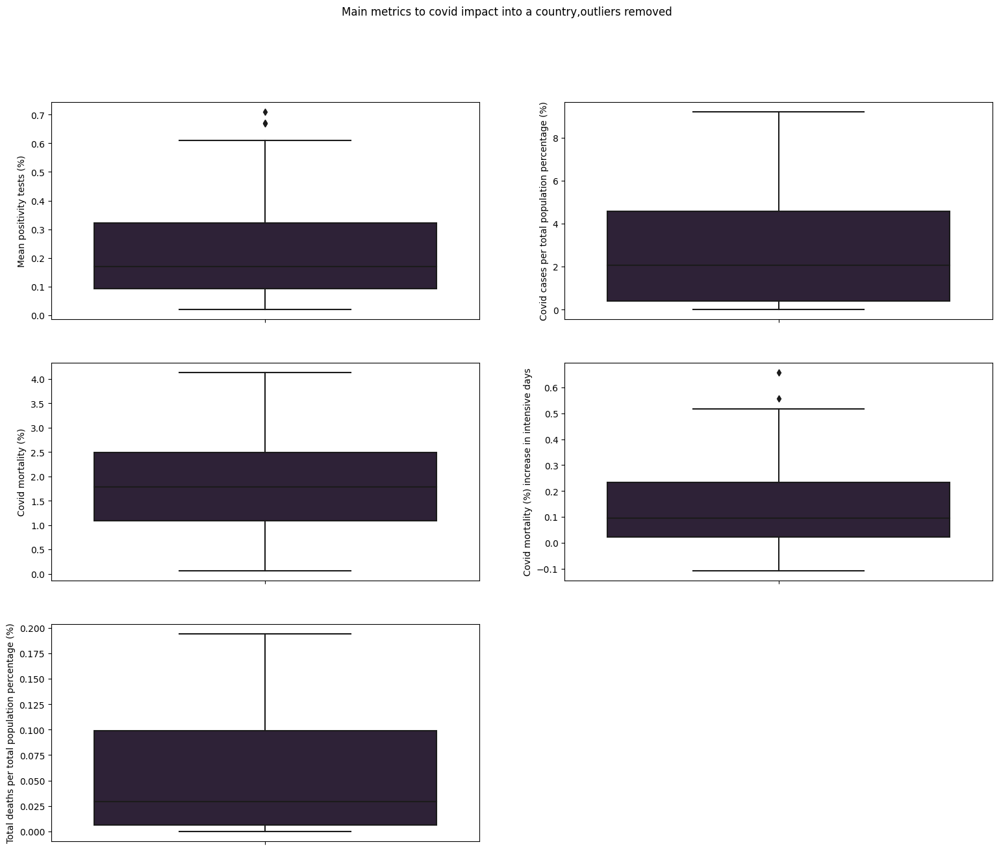

In [40]:

fig, axs = plt.subplots(3, 2 ,figsize=(18.7,14.77))
fig.suptitle('Main metrics to covid impact into a country,outliers removed')

columns=['Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)
fig.delaxes(axs[2,1])          
sns.boxplot(data=plot_data,y=columns[0],ax=axs[0,0])
sns.boxplot(data=plot_data,y=columns[1],ax=axs[0,1])
sns.boxplot(data=plot_data,y=columns[2],ax=axs[1,0])
sns.boxplot(data=plot_data,y=columns[3],ax=axs[1,1])  
sns.boxplot(data=plot_data,y=columns[4],ax=axs[2,0])  

In [41]:
sns.set_palette("mako")

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Mean positivity tests (%)'>

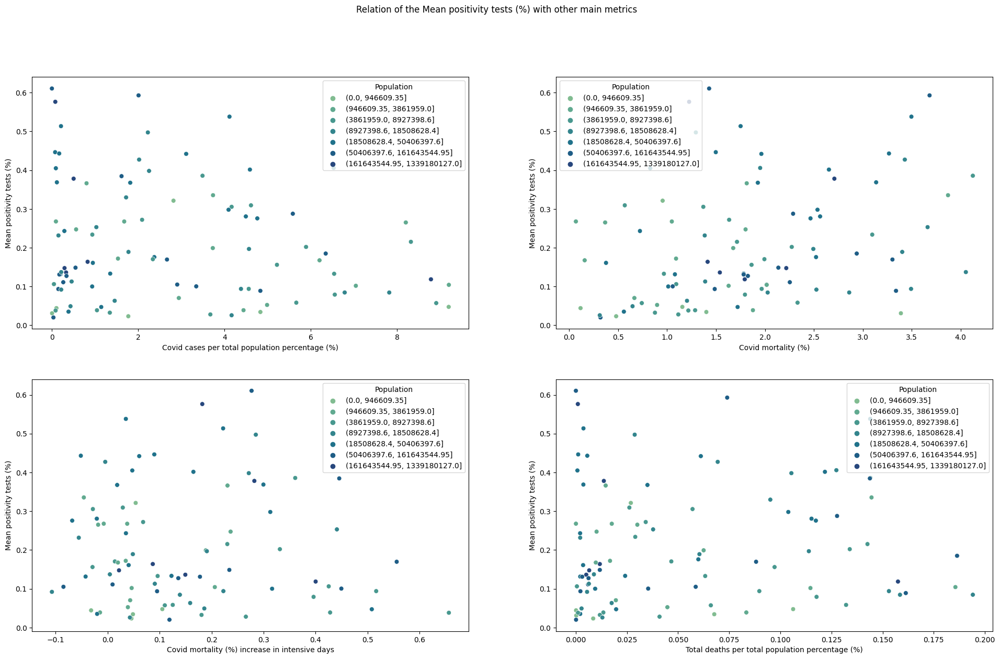

In [42]:
fig, axs = plt.subplots(2, 2 ,figsize=(23.7,13.77))
fig.suptitle('Relation of the Mean positivity tests (%) with other main metrics')
x_columns=[
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
y_column='Mean positivity tests (%)'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )                                                       

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Covid cases per total population percentage (%)'>

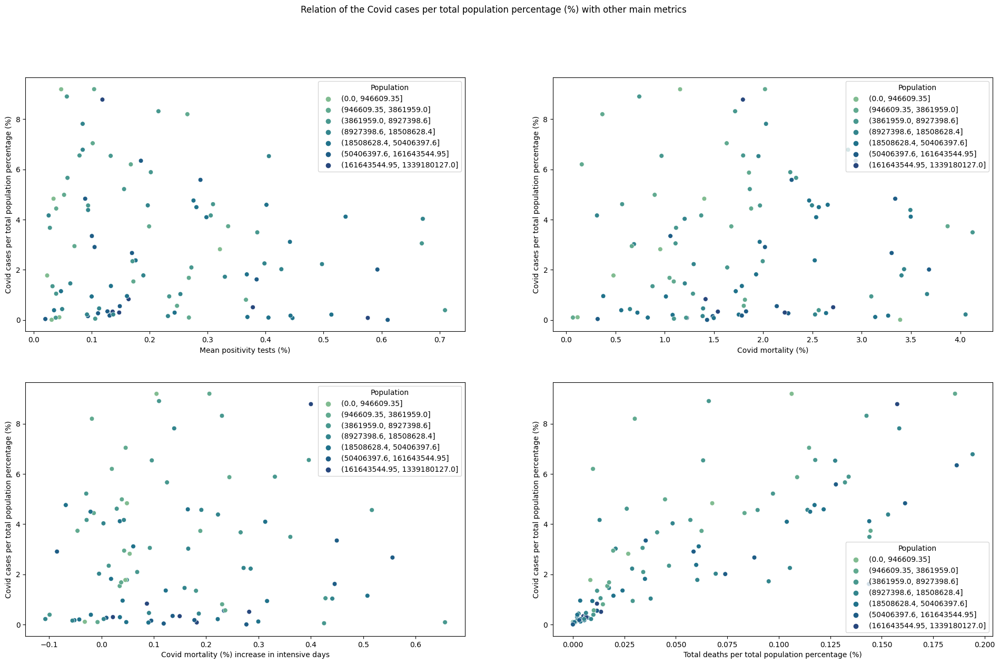

In [43]:
fig, axs = plt.subplots(2, 2 ,figsize=(23.7,13.77))
fig.suptitle('Relation of the Covid cases per total population percentage (%) with other main metrics')

x_columns=['Mean positivity tests (%)',
            'Covid mortality (%)',
            'Covid mortality (%) increase in intensive days',
            'Total deaths per total population percentage (%)'
          ]
y_column='Covid cases per total population percentage (%)'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )                                                       

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Covid mortality (%)'>

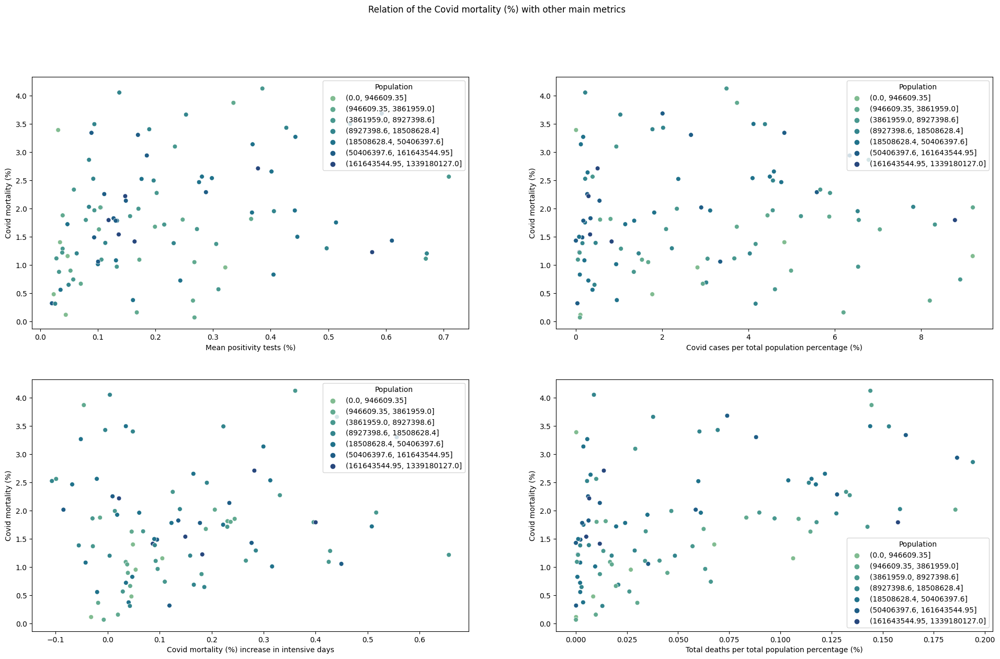

In [44]:
fig, axs = plt.subplots(2, 2 ,figsize=(23.7,13.77))
fig.suptitle('Relation of the Covid mortality (%) with other main metrics')
x_columns=['Mean positivity tests (%)',
           'Covid cases per total population percentage (%)',     
            'Covid mortality (%) increase in intensive days',
            'Total deaths per total population percentage (%)'
          ]
y_column= 'Covid mortality (%)'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )                          

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Covid mortality (%) increase in intensive days'>

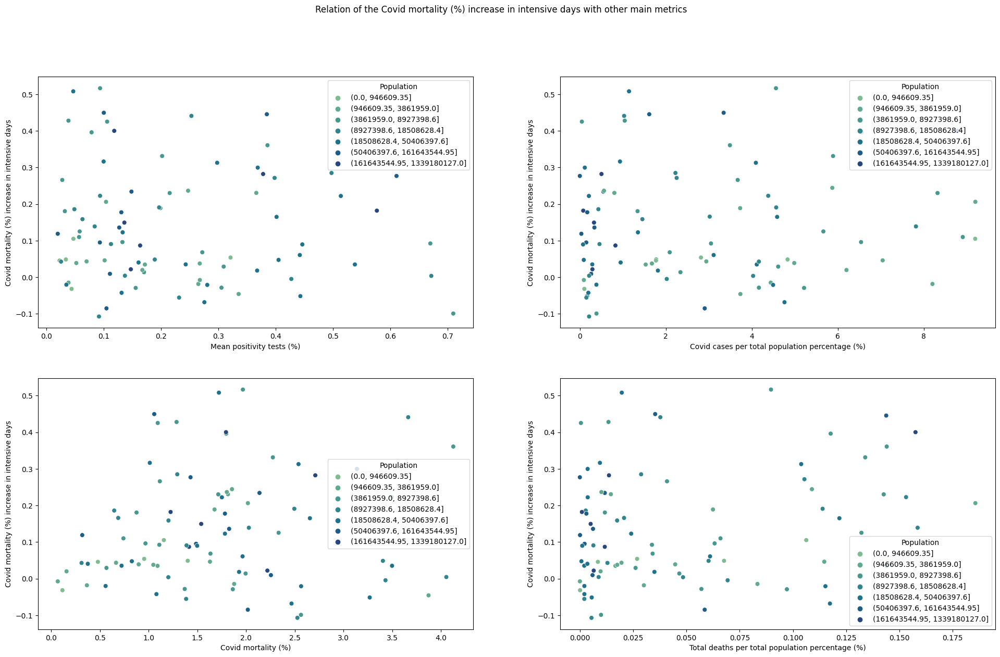

In [45]:
fig, axs = plt.subplots(2, 2 ,figsize=(23.7,13.77))
fig.suptitle('Relation of the Covid mortality (%) increase in intensive days with other main metrics')
x_columns=['Mean positivity tests (%)',
           'Covid cases per total population percentage (%)',
           'Covid mortality (%)',     
            'Total deaths per total population percentage (%)'
          ]
y_column= 'Covid mortality (%) increase in intensive days'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )                          

<Axes: xlabel='Covid mortality (%)', ylabel='Total deaths per total population percentage (%)'>

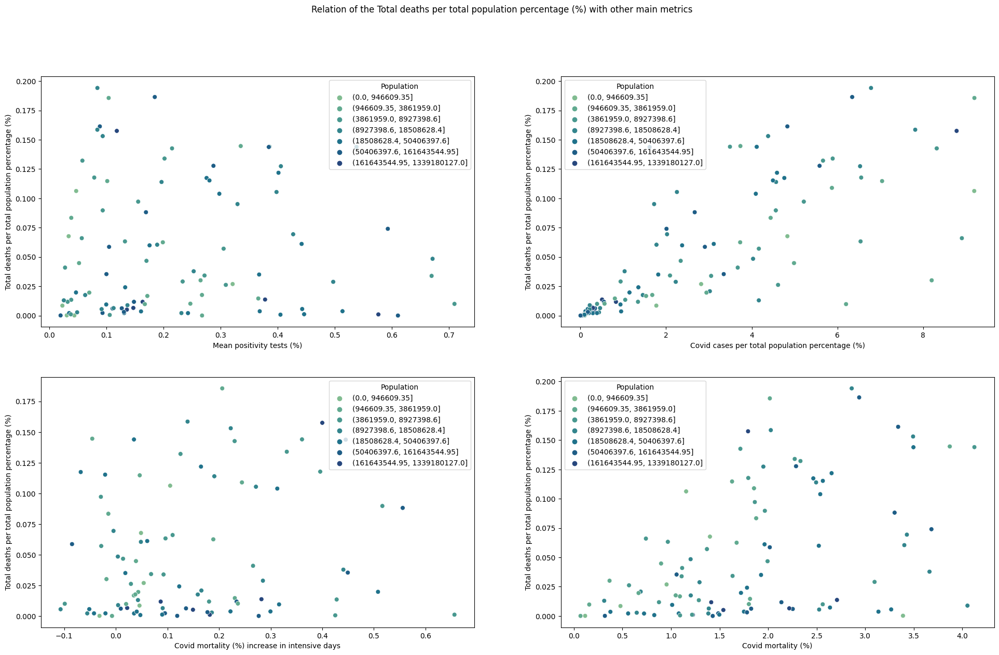

In [46]:
fig, axs = plt.subplots(2, 2 ,figsize=(23.7,13.77))
fig.suptitle('Relation of the Total deaths per total population percentage (%) with other main metrics')
x_columns=['Mean positivity tests (%)',
           'Covid cases per total population percentage (%)',     
            'Covid mortality (%) increase in intensive days',
            'Covid mortality (%)'
          ]
y_column= 'Total deaths per total population percentage (%)'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )                          

In [47]:
countries_stats.info()

<class 'pandas.core.frame.DataFrame'>
Index: 104 entries, Albania to Zimbabwe
Data columns (total 26 columns):
 #   Column                                                   Non-Null Count  Dtype  
---  ------                                                   --------------  -----  
 0   Continent                                                104 non-null    object 
 1   Latitude                                                 104 non-null    float64
 2   Longitude                                                104 non-null    float64
 3   Average temperature per year                             104 non-null    int64  
 4   Hospital beds per 1000 people                            104 non-null    float64
 5   Medical doctors per 1000 people                          104 non-null    float64
 6   GDP/Capita                                               104 non-null    float64
 7   Population                                               104 non-null    int64  
 8   Median age              

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Average temperature per year'>

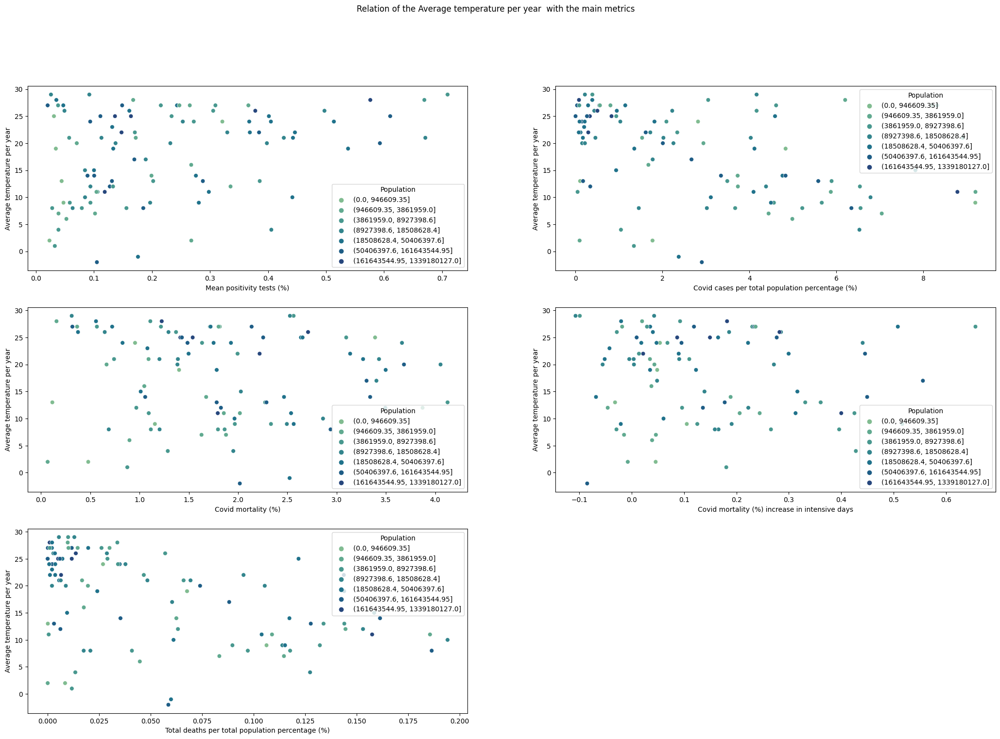

In [48]:
fig, axs = plt.subplots(3, 2 ,figsize=(25.7,16.77))
fig.suptitle('Relation of the Average temperature per year  with the main metrics')
x_columns=[
        'Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
fig.delaxes(axs[2,1])          
y_column='Average temperature per year'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )     
sns.scatterplot(data=plot_data,
                x=x_columns[4],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[2,0]
                )                                                                      

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Hospital beds per 1000 people'>

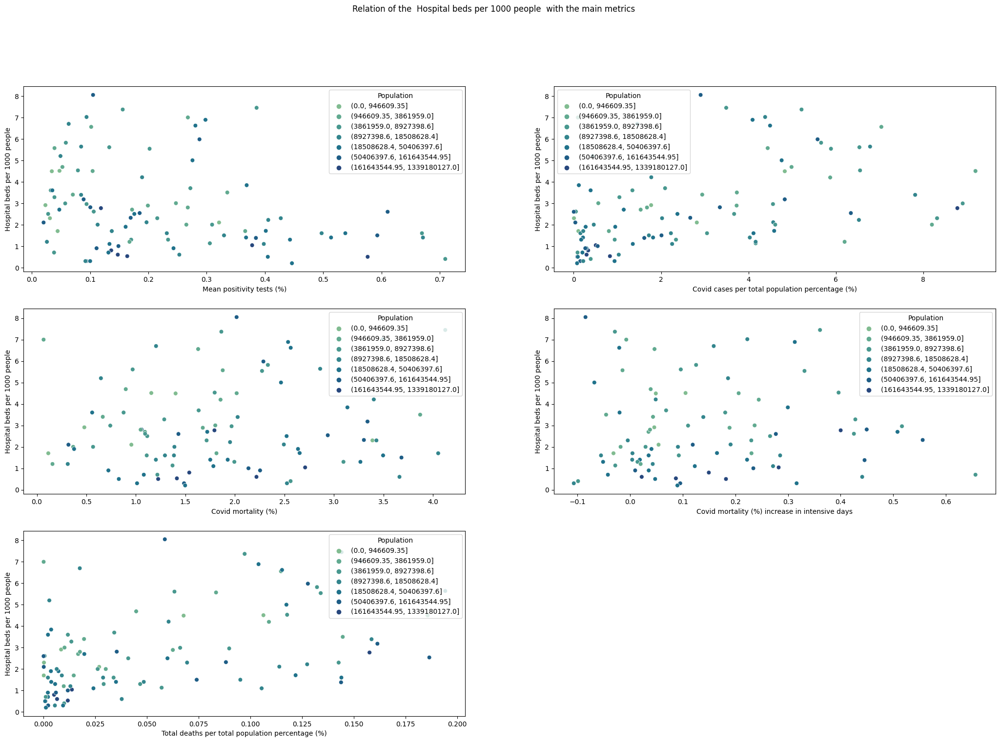

In [49]:
fig, axs = plt.subplots(3, 2 ,figsize=(25.7,16.77))
fig.suptitle('Relation of the  Hospital beds per 1000 people  with the main metrics')
x_columns=[
        'Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
fig.delaxes(axs[2,1])          
y_column='Hospital beds per 1000 people'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )     
sns.scatterplot(data=plot_data,
                x=x_columns[4],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[2,0]
                )                                                                      

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Medical doctors per 1000 people'>

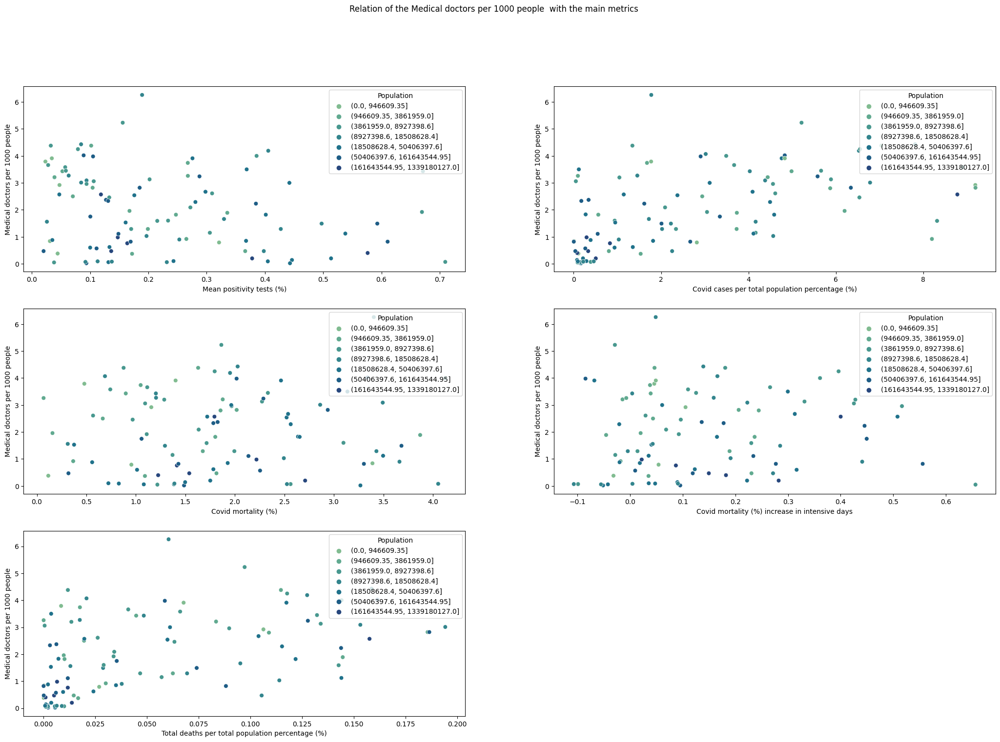

In [50]:
fig, axs = plt.subplots(3, 2 ,figsize=(25.7,16.77))
fig.suptitle('Relation of the Medical doctors per 1000 people  with the main metrics')
x_columns=[
        'Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
fig.delaxes(axs[2,1])          
y_column='Medical doctors per 1000 people'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )     
sns.scatterplot(data=plot_data,
                x=x_columns[4],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[2,0]
                )                                                                      

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='GDP/Capita'>

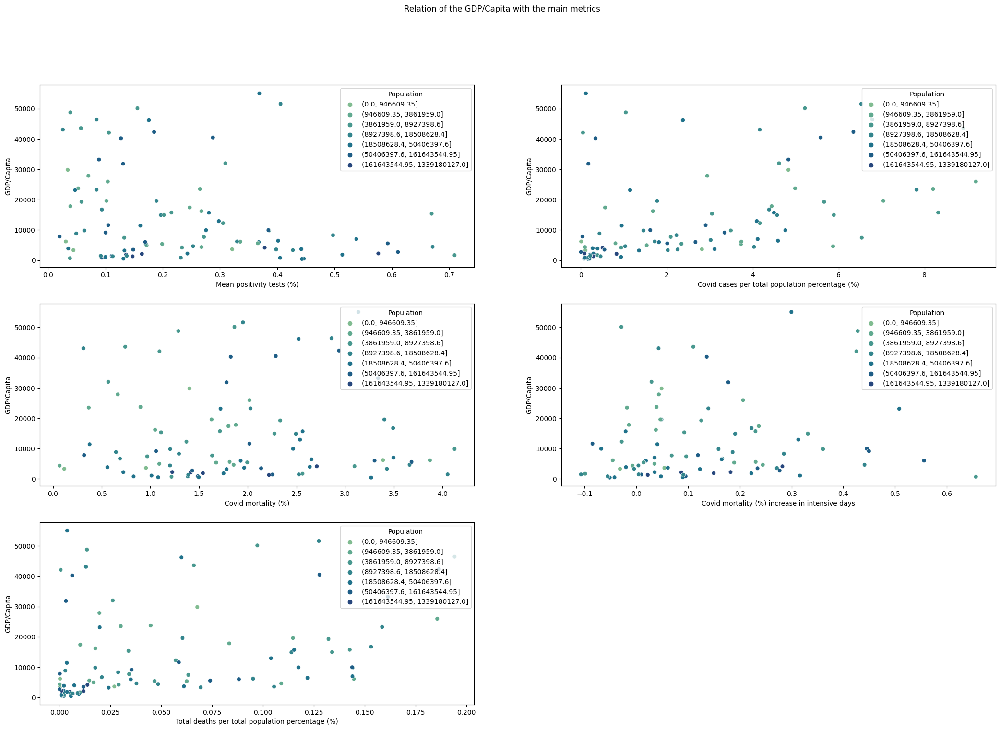

In [51]:
fig, axs = plt.subplots(3, 2 ,figsize=(25.7,16.77))
fig.suptitle('Relation of the GDP/Capita with the main metrics')
x_columns=[
        'Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
fig.delaxes(axs[2,1])          
y_column='GDP/Capita'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )     
sns.scatterplot(data=plot_data,
                x=x_columns[4],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[2,0]
                )                                                                      

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Population'>

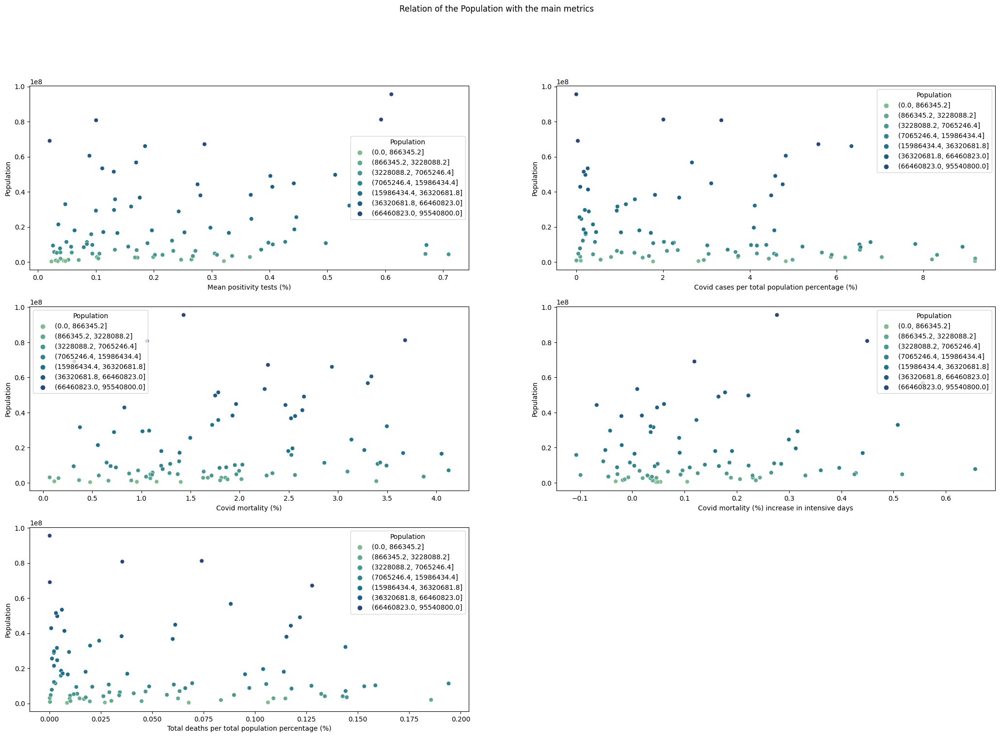

In [52]:
fig, axs = plt.subplots(3, 2 ,figsize=(25.7,16.77))
fig.suptitle('Relation of the Population with the main metrics')
x_columns=[
        'Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
fig.delaxes(axs[2,1])          
y_column='Population'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )     
sns.scatterplot(data=plot_data,
                x=x_columns[4],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[2,0]
                )                                                                      

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Median age'>

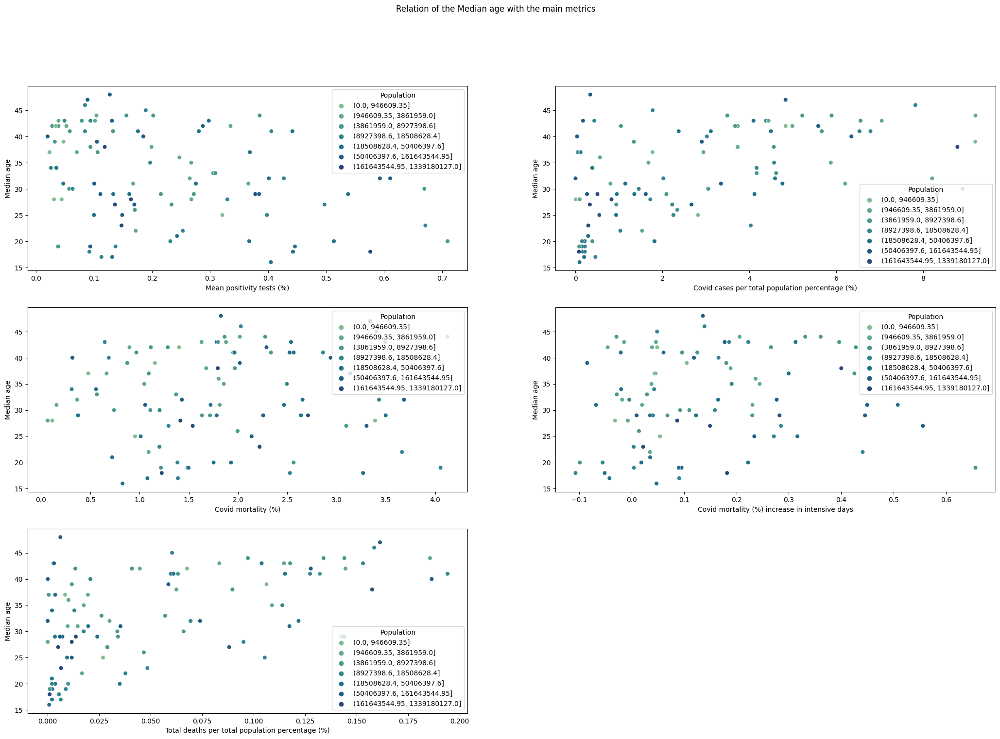

In [53]:
fig, axs = plt.subplots(3, 2 ,figsize=(25.7,16.77))
fig.suptitle('Relation of the Median age with the main metrics')
x_columns=[
        'Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
fig.delaxes(axs[2,1])          
y_column='Median age'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )     
sns.scatterplot(data=plot_data,
                x=x_columns[4],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[2,0]
                )                                                                      

<Axes: xlabel='Total deaths per total population percentage (%)', ylabel='Population aged 65 and over (%)'>

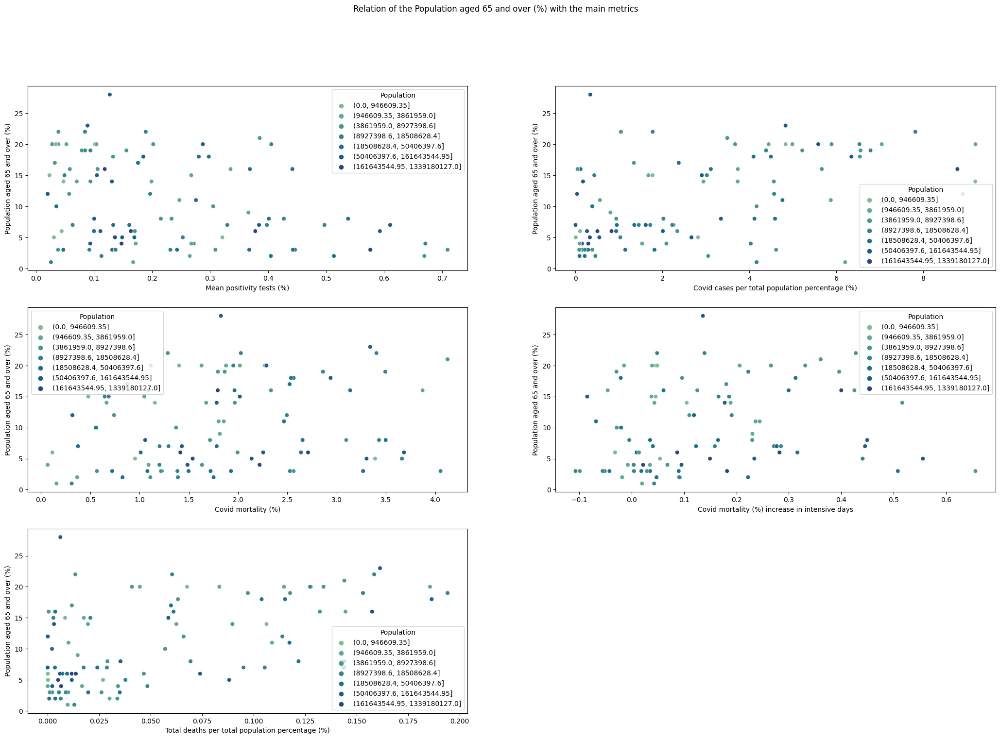

In [54]:
fig, axs = plt.subplots(3, 2 ,figsize=(25.7,16.77))
fig.suptitle('Relation of the Population aged 65 and over (%) with the main metrics')
x_columns=[
        'Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)'
          ]
fig.delaxes(axs[2,1])          
y_column='Population aged 65 and over (%)'
hue_column='Population'          
plot_data=countries_stats.copy()  
for column in columns:
     plot_data=remove_outlier(plot_data,column)


plot_data=remove_outlier(plot_data,y_column)
hue_column_data=plot_data[hue_column]
hue_bins=HueDistrubition(hue_column_data)
sns.scatterplot(data=plot_data,
                x=x_columns[0],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,0]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[1],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[0,1]
                )
sns.scatterplot(data=plot_data,
                x=x_columns[2],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,0]
                ) 
sns.scatterplot(data=plot_data,
                x=x_columns[3],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[1,1]
                )     
sns.scatterplot(data=plot_data,
                x=x_columns[4],
                y=y_column,
                hue=hue_bins,
                palette=sns.color_palette("crest",n_colors=7),
                s=40,
                ax=axs[2,0]
                )                                                                      

## Correlation of matrixes

In [55]:
#We will drop the continent column as asociation doesn't work with non-numerical values.We will also cut the total values, 
#as we are more intrested to the relative values.We will keep the percentage of total population and cut the mean per ten thousand
#for space
countries_stats_filtered=countries_stats.drop(columns=['Continent','Latitude','Longitude','Total tests','Total cases','Total deaths',
                                                      'Mean daily tests per ten thousand people of population','Mean daily cases per ten thousand people of population',
                                                      'Mean daily deaths per ten thousand people of population'])
countries_stats_filtered.corr()


,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days
Average temperature per year,1.000000,-0.594175,-0.583750,-0.476348,0.113633,-0.620798,-0.704291,-0.142552,0.235364,-0.119108,-0.128466,-0.317124,-0.376156,-0.430128,-0.005291,-0.005291,-0.012886
Hospital beds per 1000 people,-0.594175,1.000000,0.600802,0.247124,-0.122928,0.688264,0.660718,0.010866,-0.100360,-0.004669,-0.011420,0.166602,0.263772,0.268753,-0.039114,-0.039114,-0.054585
Medical doctors per 1000 people,-0.583750,0.600802,1.000000,0.521878,-0.151497,0.771743,0.737843,0.073716,-0.167346,0.051810,0.070083,0.380822,0.462420,0.410647,-0.023756,-0.023756,0.019565
GDP/Capita,-0.476348,0.247124,0.521878,1.000000,-0.095235,0.540638,0.506458,0.194461,-0.350811,0.170385,0.156460,0.638648,0.500116,0.277755,-0.155013,-0.155013,0.079393
Population,0.113633,-0.122928,-0.151497,-0.095235,1.000000,-0.092204,-0.093742,0.649252,-0.012875,0.551535,0.470232,-0.099416,-0.121050,-0.074874,0.022628,0.022628,-0.028113
Median age,-0.620798,0.688264,0.771743,0.540638,-0.092204,1.000000,0.907583,0.120131,-0.257240,0.099233,0.114026,0.403195,0.532891,0.528203,0.016346,0.016346,0.071957
Population aged 65 and over (%),-0.704291,0.660718,0.737843,0.506458,-0.093742,0.907583,1.000000,0.118894,-0.279643,0.108217,0.124046,0.313952,0.470769,0.549907,0.088927,0.088927,0.066673
Mean daily tests,-0.142552,0.010866,0.073716,0.194461,0.649252,0.120131,0.118894,1.000000,-0.130782,0.963508,0.883450,0.155244,0.221708,0.212175,-0.005400,-0.005400,0.042959
Mean positivity tests (%),0.235364,-0.100360,-0.167346,-0.350811,-0.012875,-0.257240,-0.279643,-0.130782,1.000000,-0.063807,-0.021293,-0.381869,-0.117981,-0.009995,0.217521,0.217521,-0.026232
Mean daily cases,-0.119108,-0.004669,0.051810,0.170385,0.551535,0.099233,0.108217,0.963508,-0.063807,1.000000,0.946932,0.076594,0.253115,0.271614,0.063941,0.063941,0.056031


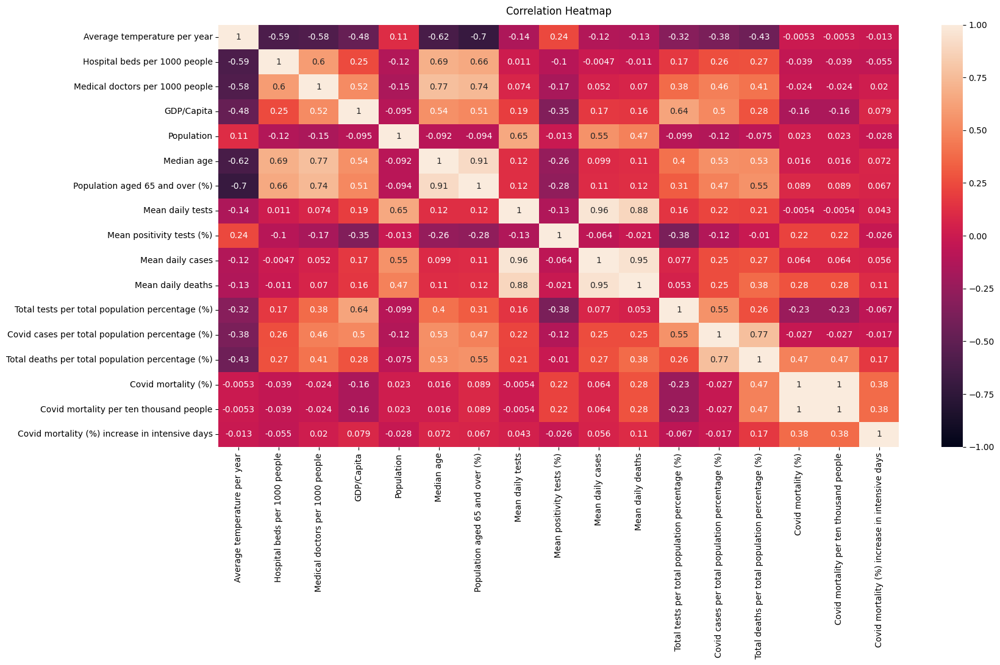

In [56]:
# Increase the size of the heatmap.
plt.figure(figsize=(18, 9))
# # Store heatmap object in a variable to easily access it when you want to include more features (such as title).
# Set the range of values to be displayed on the colormap from -1 to 1, and set the annotation to True to display the correlation values on the heatmap.
heatmap = sns.heatmap(countries_stats_filtered.corr(), vmin=-1, vmax=1, annot=True)
 # Give a title to the heatmap. Pad defines the distance of the title from the top of the heatmap.
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

# Clustering

In [57]:

from sklearn.cluster import KMeans
import yellowbrick
from sklearn import metrics
from sklearn.metrics import silhouette_score





## Find amount of centers

In [58]:
main_factors=['Mean positivity tests (%)',
        'Covid cases per total population percentage (%)',
        'Covid mortality (%)',
        'Covid mortality (%) increase in intensive days',
        'Total deaths per total population percentage (%)']


877.6914802214827
365.59761777305107
260.9511636672601
183.1381862748778
153.5477926688024
147.4910096657664
118.72129868810218
93.27569113536478
81.38216133870661


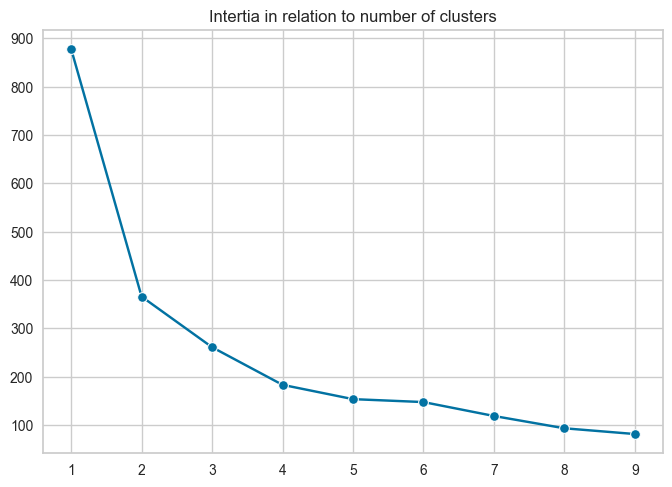

In [59]:
X=countries_stats_filtered[main_factors]
inertias = []
K = range(1, 10)
 
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k,n_init='auto')

    kmeanModel.fit(X)
    inertias.append(kmeanModel.inertia_)
sns.lineplot(x=K,y=inertias,marker='o').set(title='Intertia in relation to number of clusters')    
for intertia in inertias:
    print(intertia)


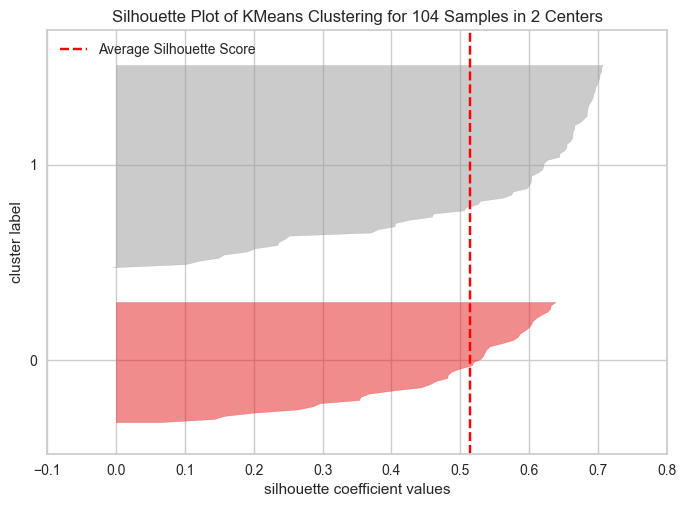

2


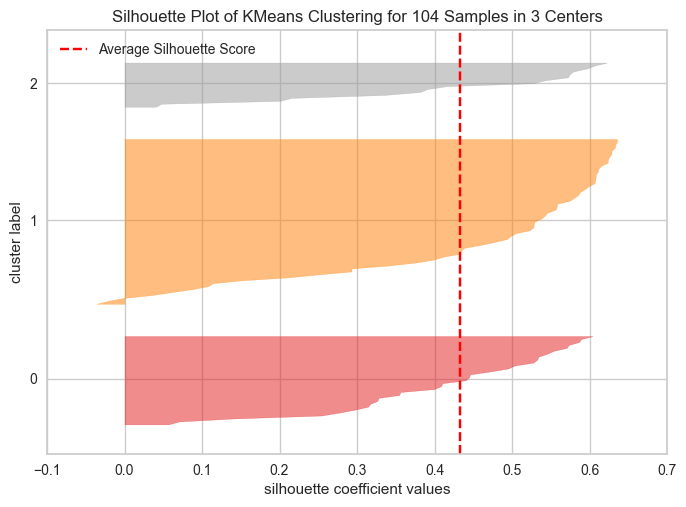

3


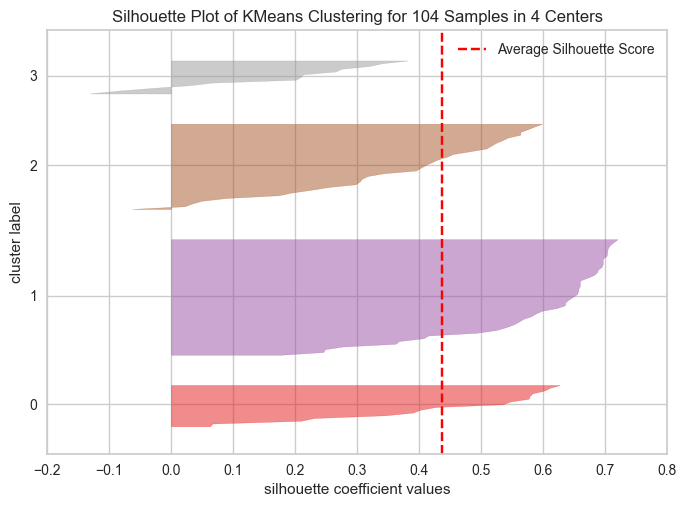

4


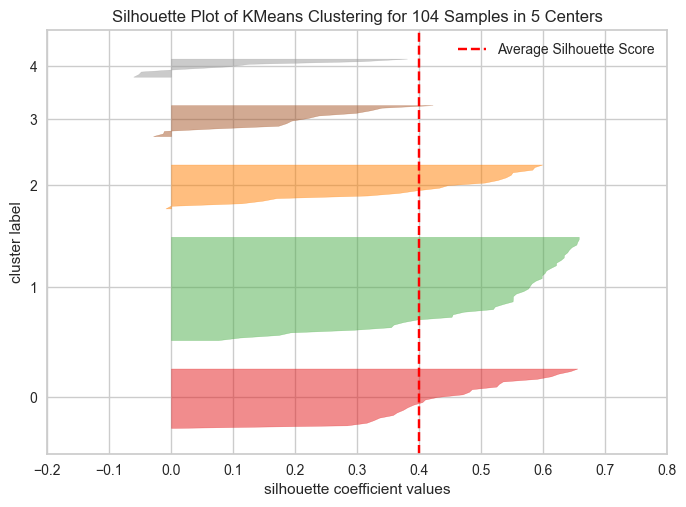

5


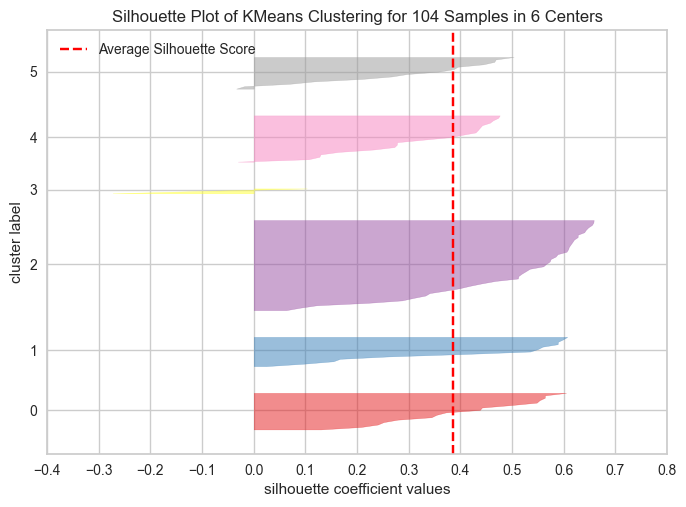

6


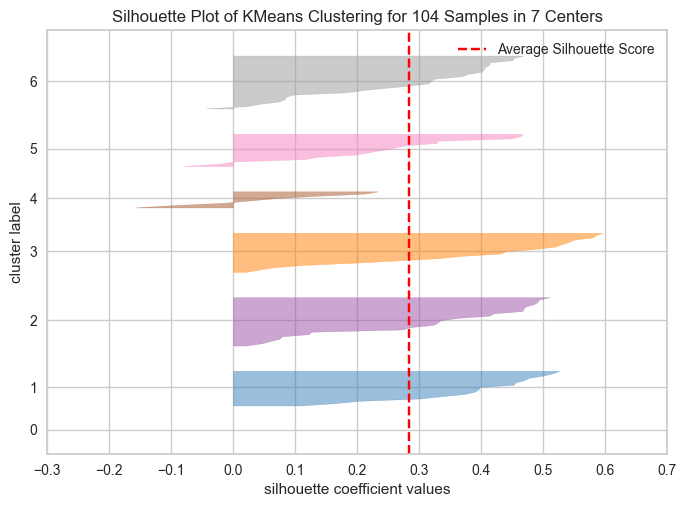

7


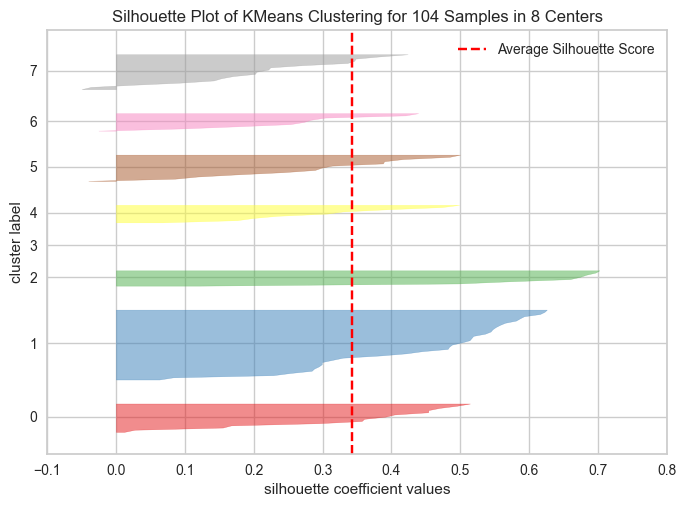

8


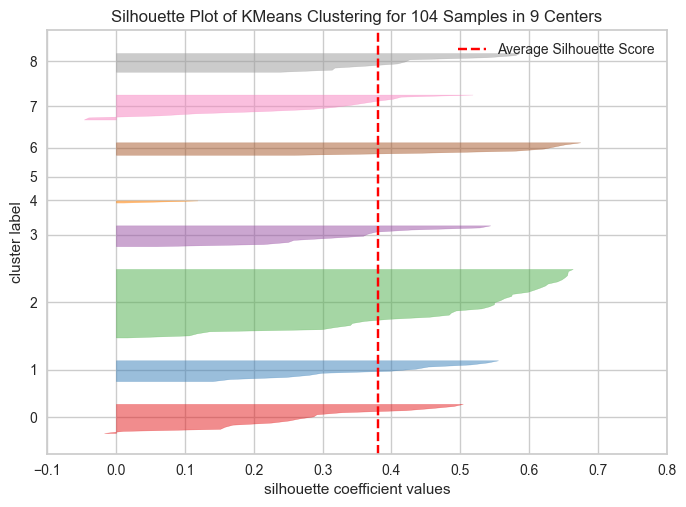

9


In [60]:
from yellowbrick.cluster import  SilhouetteVisualizer
import numpy as np

for k in range(2,10):
    kmeans = KMeans(n_clusters=k,n_init='auto')
    sil_vis = SilhouetteVisualizer(kmeans)
    sil_vis.fit(X)
    sil_vis.show()
    test = KMeans(n_clusters=k,n_init=10)
    test.fit(X)
    print(len(set(test.labels_)))

We see that even though in the silhouette score, the difference isn't so big,with the 4 clusters we can differiate between the clusters and find more clear trends of countries going well or not

In [61]:
kmeans = KMeans(n_clusters=3,n_init='auto')
countries_stats_filtered['Cluster']=kmeans.fit_predict(X)
print('For 3 clusters')
for factor in main_factors:
    print(countries_stats_filtered.groupby('Cluster')[factor].mean())
print(countries_stats_filtered.groupby('Cluster').describe())    

For 3 clusters
Cluster
0   0.284485
1   0.230472
2   0.182575
Name: Mean positivity tests (%), dtype: float64
Cluster
0   3.464411
1   0.618428
2   6.980862
Name: Covid cases per total population percentage (%), dtype: float64
Cluster
0   2.526483
1   1.640359
2   1.681593
Name: Covid mortality (%), dtype: float64
Cluster
0   0.258899
1   0.237639
2   0.301407
Name: Covid mortality (%) increase in intensive days, dtype: float64
Cluster
0   0.080210
1   0.009510
2   0.115239
Name: Total deaths per total population percentage (%), dtype: float64
        Average temperature per year                                         \
                               count      mean      std       min       25%   
Cluster                                                                       
0                          35.000000 16.000000 7.654295 -2.000000 10.500000   
1                          49.000000 21.102041 7.509008  1.000000 20.000000   
2                          20.000000 12.900000 7.181116

In [62]:
countries_stats_filtered.sort_values('Cluster').head(25)

,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days,Cluster
Country,,,,,,,,,,,,,,,,,,
Albania,14,2.890000,1.290000,5353.200000,2873457,38,14,1183,0.199110,302,5.059155,15.235481,3.729549,0.062503,1.675889,167.588903,0.188874,0
Ecuador,22,1.500000,1.660000,6183.800000,16624858,28,7,2575,0.329773,793,43.797784,5.652818,1.721248,0.095105,5.525327,552.532718,2.145137,0
South Africa,17,2.320000,0.820000,6001.400000,56717156,27,5,24444,0.169571,4263,140.825352,15.687742,2.668316,0.088144,3.303372,330.337196,0.555912,0
Mexico,22,1.380000,2.230000,9946.000000,129163276,29,7,11813,0.384537,5895,524.618644,3.886928,1.615736,0.143783,8.898923,889.892273,0.445442,0
Russia,-2,8.050000,3.980000,11585.000000,144495044,39,15,262092,0.105022,11662,235.277778,71.647102,2.905567,0.058618,2.017435,201.743521,-0.084920,0
Romania,11,6.890000,2.670000,12919.500000,19586539,43,18,13458,0.297968,2240,56.843575,25.354796,4.094618,0.103898,2.537425,253.742547,0.312844,0
Greece,17,4.210000,6.260000,19582.500000,10760421,45,22,12692,0.189182,529,18.016620,43.523381,1.775953,0.060444,3.403454,340.345369,0.048523,0
Poland,9,6.620000,2.290000,15692.500000,37975841,41,18,25970,0.280687,4768,122.259777,24.755518,4.494926,0.115255,2.564110,256.411007,-0.020779,0
Hungary,12,7.020000,3.090000,16731.800000,9781127,43,19,8740,0.093859,1207,42.180282,32.346784,4.381898,0.153091,3.493709,349.370857,0.222635,0


## First evaluation of the formed clusters

In [63]:
kmeans = KMeans(n_clusters=4,n_init='auto')
countries_stats_filtered['Cluster']=kmeans.fit_predict(X)
print('For 4 clusters')
for factor in main_factors:
    print(countries_stats_filtered.groupby('Cluster')[factor].mean())

For 4 clusters
Cluster
0   0.288794
1   0.234969
2   0.193571
3   0.248313
Name: Mean positivity tests (%), dtype: float64
Cluster
0   1.847366
1   0.661931
2   7.385536
3   4.167646
Name: Covid cases per total population percentage (%), dtype: float64
Cluster
0   4.117482
1   1.481933
2   1.640568
3   1.799057
Name: Covid mortality (%), dtype: float64
Cluster
0   0.732201
1   0.148835
2   0.318054
3   0.162422
Name: Covid mortality (%) increase in intensive days, dtype: float64
Cluster
0   0.075767
1   0.009494
2   0.118933
3   0.077775
Name: Total deaths per total population percentage (%), dtype: float64


In [64]:
countries_stats_filtered.sort_values('Cluster')

,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days,Cluster
Country,,,,,,,,,,,,,,,,,,
Zimbabwe,20,1.700000,0.080000,1464.000000,16529904,19,3,1063,0.137173,110,4.457317,2.225579,0.218326,0.008851,4.053867,405.386683,0.004341,0
Guatemala,24,0.600000,0.900000,4620.000000,16913503,22,5,2404,0.253067,504,18.473988,5.173186,1.031968,0.037798,3.662729,366.272874,0.440940,0
Greece,17,4.210000,6.260000,19582.500000,10760421,45,22,12692,0.189182,529,18.016620,43.523381,1.775953,0.060444,3.403454,340.345369,0.048523,0
Fiji,25,2.300000,0.840000,6175.900000,905502,28,5,69,0.030990,0,0.006042,2.695632,0.006516,0.000221,3.389831,338.983051,3.389831,0
South Africa,17,2.320000,0.820000,6001.400000,56717156,27,5,24444,0.169571,4263,140.825352,15.687742,2.668316,0.088144,3.303372,330.337196,0.555912,0
El Salvador,25,1.300000,1.600000,4187.300000,6377853,27,8,1498,0.233775,176,5.452941,8.150909,0.938654,0.029069,3.096916,309.691645,0.976704,0
Ecuador,22,1.500000,1.660000,6183.800000,16624858,28,7,2575,0.329773,793,43.797784,5.652818,1.721248,0.095105,5.525327,552.532718,2.145137,0
Canada,-1,2.500000,2.540000,46194.700000,36708083,41,17,43695,0.175845,2356,59.432432,47.613611,2.374665,0.059905,2.522674,252.267424,0.704984,0
Bulgaria,13,7.450000,4.000000,9828.100000,7075991,44,21,4043,0.385672,700,28.866856,20.454435,3.491214,0.144022,4.125276,412.527627,0.360777,0


In [65]:
print(countries_stats_filtered.groupby('Cluster').size())
print(countries_stats_filtered.groupby('Cluster')['Mean daily tests'].mean())
print(countries_stats_filtered.groupby('Cluster')['Mean daily cases'].mean())
print(countries_stats_filtered.groupby('Cluster')['Mean daily deaths'].mean())
print(countries_stats_filtered.groupby('Cluster')['Population'].mean())

Cluster
0    14
1    46
2    16
3    28
dtype: int64
Cluster
0    8924.000000
1   18242.217391
2   73429.687500
3   34477.071429
Name: Mean daily tests, dtype: float64
Cluster
0   1530.642857
1   1156.608696
2   6191.312500
3   2717.607143
Name: Mean daily cases, dtype: float64
Cluster
0    76.774219
1    18.356417
2   118.014505
3    61.214205
Name: Mean daily deaths, dtype: float64
Cluster
0   28930719.928571
1   72896285.021739
2   29278507.250000
3   24431564.857143
Name: Population, dtype: float64


### Assigning to each label a name based of the main factors's results

In [66]:
#Those are the values that have the most extreme values for the different clusters
clusters_factors=countries_stats_filtered.groupby('Cluster')[['Covid cases per total population percentage (%)','Covid mortality (%)']].mean()

In [67]:
#Every time the clusters form in different ways, but the below characteristics all persists in every execution for the 4 clusters
countries_stats_filtered.loc[countries_stats_filtered['Cluster']==clusters_factors['Covid cases per total population percentage (%)'].idxmax(),'Cluster']='High amount of Covid cases per population'
countries_stats_filtered.loc[countries_stats_filtered['Cluster']==clusters_factors['Covid mortality (%)'].idxmax(),'Cluster']='High amount of Covid mortality per population'
countries_stats_filtered.loc[countries_stats_filtered['Cluster']==clusters_factors['Covid cases per total population percentage (%)'].idxmin(),'Cluster']='Low amount of Covid cases per population'
#The only one that it haven't been observed to have any extreme value it the last remaining one that still has a numeric values assigned by the  sklearn clustering method
countries_stats_filtered.loc[countries_stats_filtered['Cluster']==pd.to_numeric(countries_stats_filtered['Cluster'],errors='coerce'),'Cluster']='Averag to high metrics'



In [68]:
countries_stats_filtered.head(10)

,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days,Cluster
Country,,,,,,,,,,,,,,,,,,
Albania,14,2.890000,1.290000,5353.200000,2873457,38,14,1183,0.199110,302,5.059155,15.235481,3.729549,0.062503,1.675889,167.588903,0.188874,Averag to high metrics
Algeria,25,1.900000,1.830000,3974.000000,41318142,29,6,313,0.967895,312,8.240331,0.279957,0.273710,0.007220,2.637676,263.767552,0.712304,Low amount of Covid cases per population
Argentina,14,5.000000,3.910000,9912.300000,44271041,31,11,15214,0.275673,5886,145.153631,13.883462,4.760143,0.117379,2.465876,246.587563,-0.068100,Averag to high metrics
Armenia,11,4.200000,2.800000,4622.700000,2930450,35,11,713,0.846233,489,9.068182,8.878602,5.871385,0.108925,1.855188,185.518837,0.244351,High amount of Covid cases per population
Australia,22,3.840000,3.500000,55060.300000,24598933,37,16,23366,0.368665,74,2.307107,37.995258,0.117802,0.003695,3.136862,313.686245,0.299606,Low amount of Covid cases per population
Austria,8,7.370000,5.230000,50137.700000,8809212,44,19,38621,0.155932,1259,23.454795,162.215145,5.215449,0.097182,1.863355,186.335539,-0.029031,Averag to high metrics
Bahrain,27,2.000000,0.920000,23504.000000,1492584,32,2,7015,0.265136,331,1.213514,174.369483,8.200141,0.030082,0.366848,36.684805,-0.018220,High amount of Covid cases per population
Bangladesh,25,0.800000,0.470000,1855.700000,164669751,27,5,11056,0.136186,1570,24.160920,2.430534,0.331704,0.005106,1.539318,153.931778,0.149450,Low amount of Covid cases per population
Belarus,8,11.000000,4.070000,6663.300000,9507875,40,15,1992,0.810738,812,5.581921,7.689342,3.021769,0.020783,0.687768,68.776844,0.165781,Averag to high metrics


## Exploration of clusters

In [69]:
#Put back continents and coordinates into the data
countries_stats_filtered[['Longitude','Latitude','Continent']]=countries_stats[['Longitude','Latitude','Continent']]

In [70]:
print(countries_stats_filtered.groupby('Cluster').describe())

                                              Average temperature per year  \
                                                                     count   
Cluster                                                                      
Averag to high metrics                                           28.000000   
High amount of Covid cases per population                        16.000000   
High amount of Covid mortality per population                    14.000000   
Low amount of Covid cases per population                         46.000000   

                                                                            \
                                                   mean      std       min   
Cluster                                                                      
Averag to high metrics                        14.678571 7.897743 -2.000000   
High amount of Covid cases per population     13.875000 7.649619  4.000000   
High amount of Covid mortality per population 18.357143 6.84562

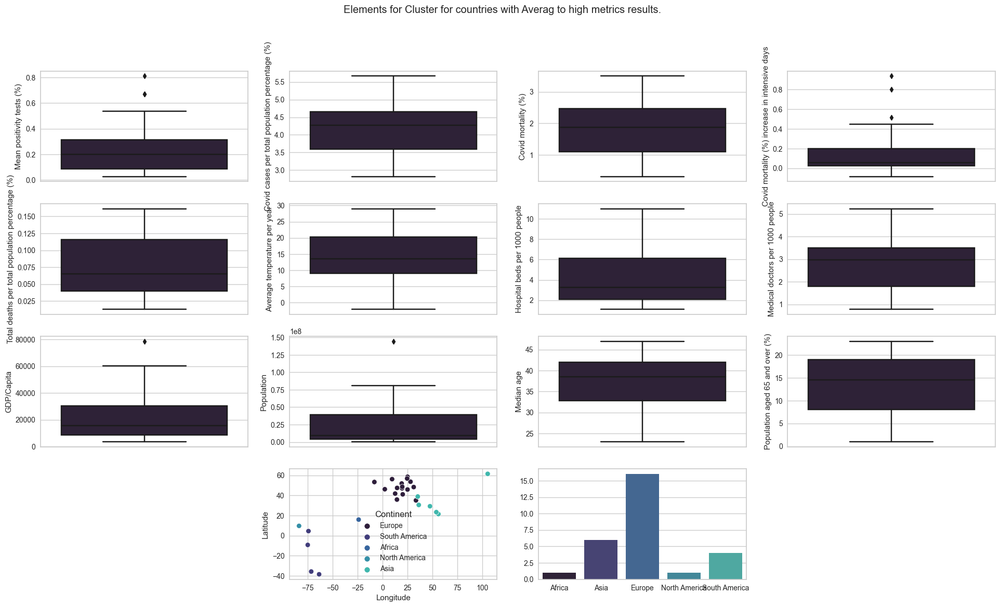

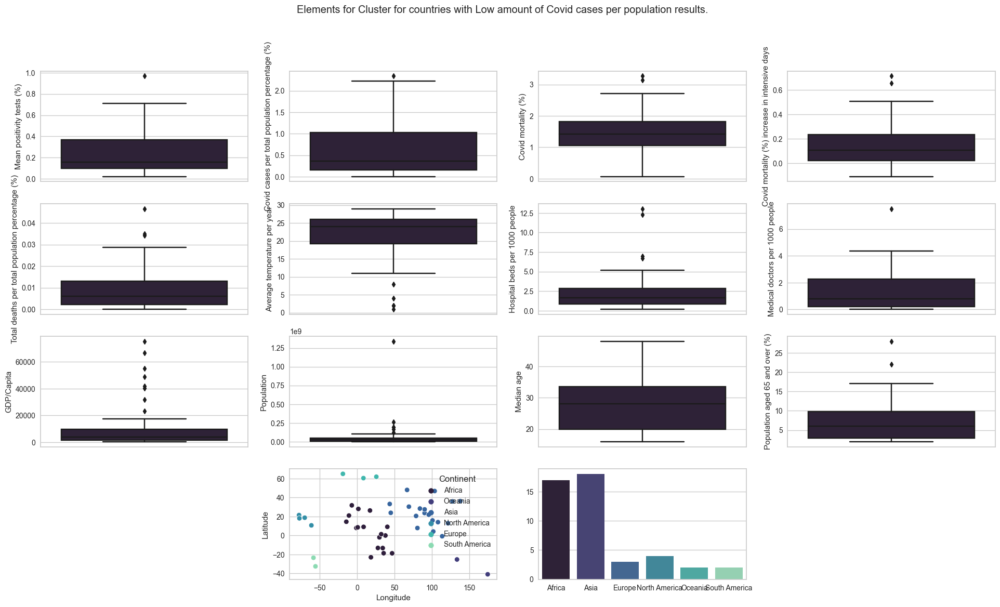

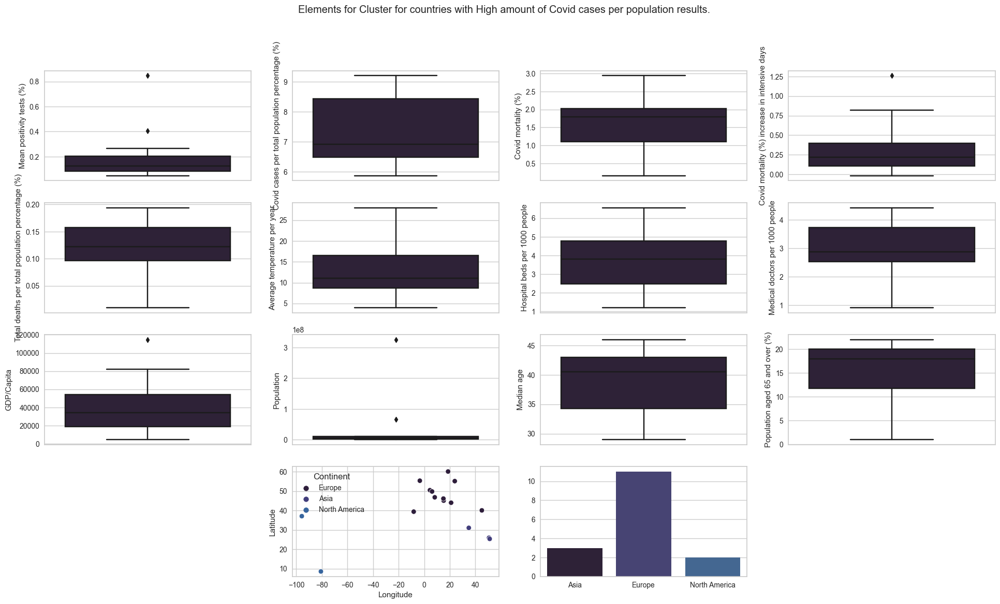

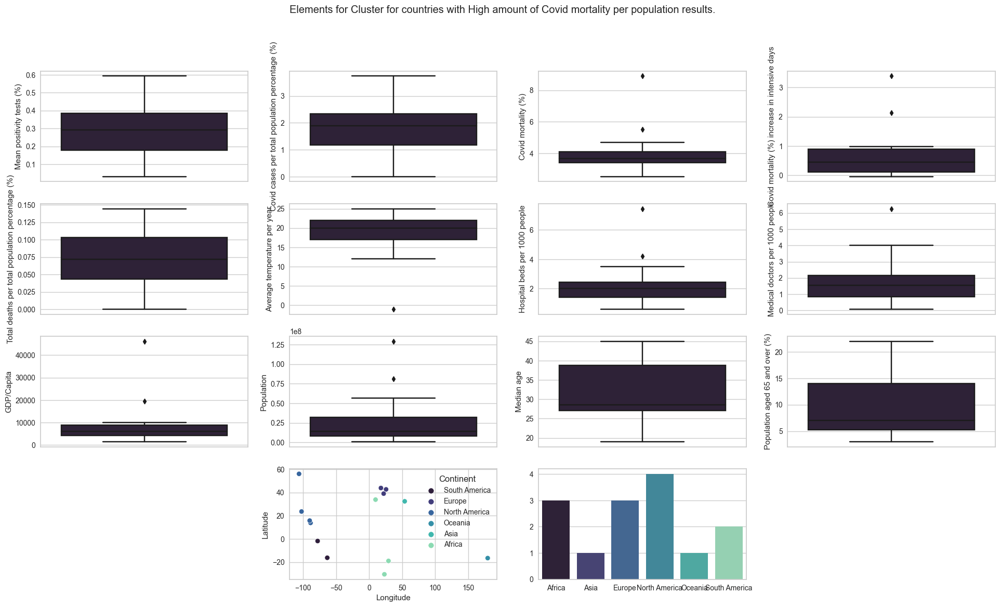

In [71]:
sns.set_palette("mako")

for cluster in countries_stats_filtered['Cluster'].unique():
    plot_data=countries_stats_filtered.copy()
    fig, axs = plt.subplots(4, 4 ,figsize=(23.7,12.7))
    title='Elements for Cluster for countries with '+ cluster +' results.'
    fig.suptitle(title)
    column=[  'Mean positivity tests (%)',
                'Covid cases per total population percentage (%)',
                'Covid mortality (%)',
            'Covid mortality (%) increase in intensive days',
            'Total deaths per total population percentage (%)',
            'Average temperature per year',
            'Hospital beds per 1000 people',
            'Medical doctors per 1000 people',
            'GDP/Capita',
            'Population',
            'Median age',
            'Population aged 65 and over (%)',
            'Longitude',
            'Latitude',
            'Continent',
            ]
    axs=axs.flatten()        
    fig.delaxes(axs[12])          
    fig.delaxes(axs[15])  
    cluster_data=plot_data.loc[plot_data['Cluster']==cluster]           
    for i in range(12):       
     
        sns.boxplot(data=cluster_data,y=column[i],ax=axs[i])
    
    sns.scatterplot(data=cluster_data,x=column[12],y=column[13],hue=column[14],ax=axs[13])  

    continents, cnt = np.unique(cluster_data[column[14]], return_counts=True)

    sns.barplot(x=continents,y=cnt,ax=axs[14]) 

In [72]:
for cluster in countries_stats_filtered['Cluster'].unique():
   
    print("The countries which are in the",cluster)
    print(countries_stats_filtered.loc[plot_data['Cluster']==cluster])           
    

The countries which are in the Averag to high metrics
                      Average temperature per year  \
Country                                              
Albania                                         14   
Argentina                                       14   
Austria                                          8   
Belarus                                          8   
Cape Verde                                      24   
Chile                                            9   
Colombia                                        25   
Costa Rica                                      26   
Cyprus                                          20   
Denmark                                          8   
Estonia                                          6   
France                                          13   
Hungary                                         12   
Ireland                                          9   
Italy                                           14   
Jordan                      

In [73]:
countries_stats_filtered.sort_values(by=['Cluster','Mean positivity tests (%)'])     

,Average temperature per year,Hospital beds per 1000 people,Medical doctors per 1000 people,GDP/Capita,Population,Median age,Population aged 65 and over (%),Mean daily tests,Mean positivity tests (%),Mean daily cases,Mean daily deaths,Total tests per total population percentage (%),Covid cases per total population percentage (%),Total deaths per total population percentage (%),Covid mortality (%),Covid mortality per ten thousand people,Covid mortality (%) increase in intensive days,Cluster,Longitude,Latitude,Continent
Country,,,,,,,,,,,,,,,,,,,,,
United Arab Emirates,29,1.200000,1.560000,43103.300000,9400145,34,1,76223,0.025845,1050,3.273458,321.915215,4.165085,0.012989,0.311858,31.185828,0.042860,Averag to high metrics,53.850000,23.420000,Asia
Denmark,8,2.500000,3.660000,60170.300000,5769603,42,20,43295,0.027967,585,6.524862,282.900626,3.672402,0.040939,1.114766,111.476617,0.265875,Averag to high metrics,9.500000,56.260000,Europe
Malta,19,4.490000,3.910000,29820.600000,465292,42,20,1862,0.034251,64,0.892351,148.031559,4.831805,0.067699,1.401121,140.112090,0.048719,Averag to high metrics,14.380000,35.940000,Europe
Latvia,7,5.570000,3.210000,17828.900000,1940740,43,20,3913,0.038845,244,4.583569,73.795872,4.440883,0.083370,1.877335,187.733507,-0.014570,Averag to high metrics,24.600000,56.880000,Europe
Estonia,6,4.690000,3.430000,23723.300000,1315480,42,20,2508,0.052442,184,1.654494,70.163362,4.986773,0.044775,0.897866,89.786585,0.038974,Averag to high metrics,25.010000,58.600000,Europe
Slovakia,9,5.820000,3.450000,19266.300000,5439892,41,16,39678,0.058319,870,20.307910,262.577309,5.663403,0.132153,2.333462,233.346209,0.125271,Averag to high metrics,19.700000,48.670000,Europe
Cyprus,20,3.400000,2.500000,27858.400000,1179551,37,14,6065,0.070335,98,0.654391,183.568493,2.942391,0.019584,0.665572,66.557179,0.043386,Averag to high metrics,33.430000,35.130000,Europe
Italy,14,3.180000,4.020000,33228.200000,60551416,47,23,99610,0.088858,7822,261.227273,64.979306,4.831043,0.161349,3.339834,333.983417,0.937120,Averag to high metrics,12.570000,41.870000,Europe
Hungary,12,7.020000,3.090000,16731.800000,9781127,43,19,8740,0.093859,1207,42.180282,32.346784,4.381898,0.153091,3.493709,349.370857,0.222635,Averag to high metrics,19.500000,47.160000,Europe


# Regression machine

In [99]:
from sklearn.svm import SVR
from sklearn.preprocessing import MinMaxScaler


In [124]:
country_to_be_trained=data_days_stats['Greece'].copy()
general_country_info=countries_stats.loc['Greece']


<Axes: xlabel='Date', ylabel='Daily tests positivity (%)'>

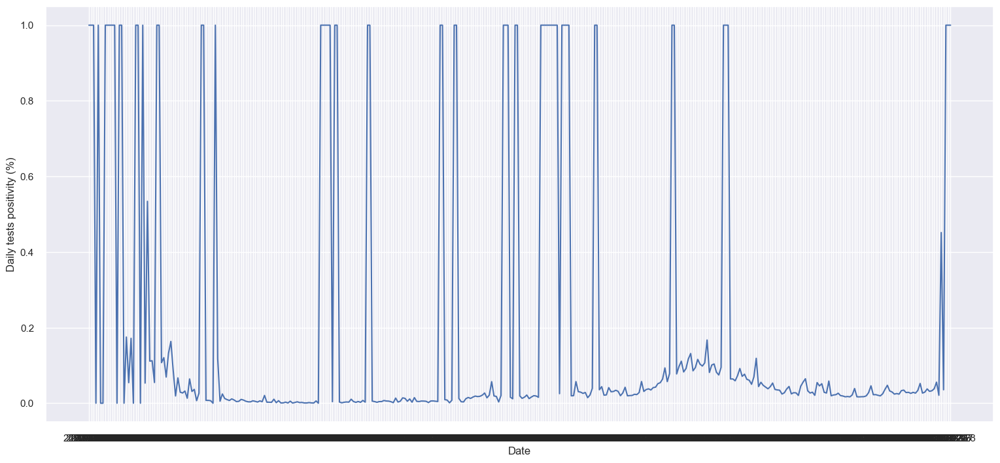

In [125]:
sns.set(rc={'figure.figsize':(18.7,8.27)})

sns.lineplot(data=country_to_be_trained,x='Date',y='Daily tests positivity (%)')

<Axes: xlabel='Date', ylabel='Daily tests'>

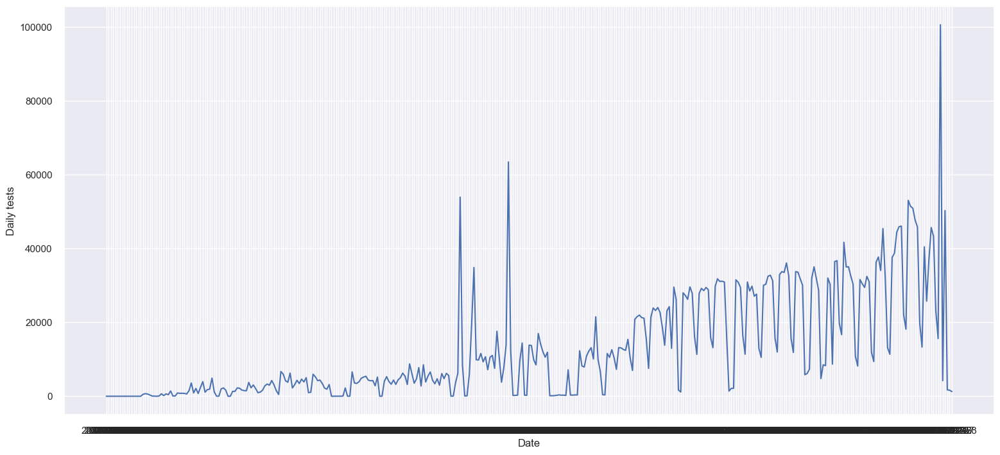

In [126]:
sns.set(rc={'figure.figsize':(18.7,8.27)})

sns.lineplot(data=country_to_be_trained,x='Date',y='Daily tests')

<Axes: xlabel='Date', ylabel='Daily cases'>

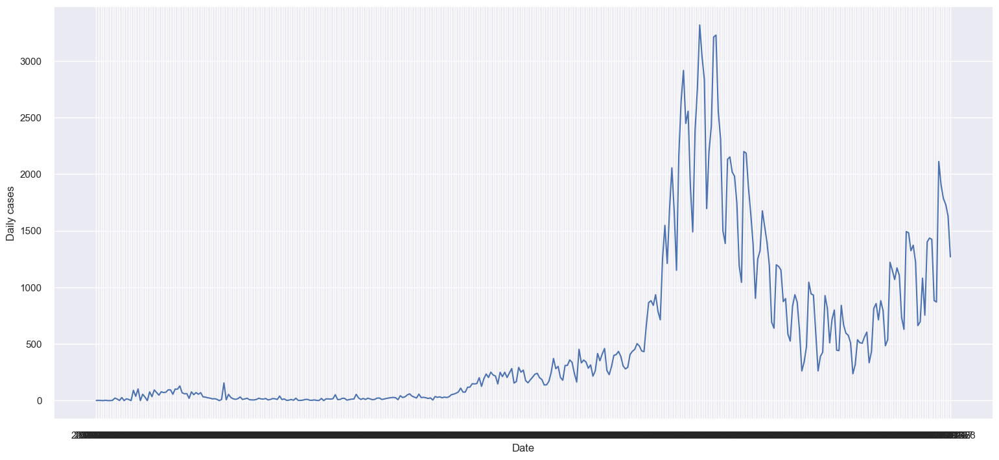

In [127]:
sns.set(rc={'figure.figsize':(18.7,8.27)})

sns.lineplot(data=country_to_be_trained,x='Date',y='Daily cases')

In [104]:
country_to_be_trained.index
country_to_be_trained=country_to_be_trained.set_index(pd.to_datetime(country_to_be_trained.index))

In [105]:
country_to_be_trained.index

DatetimeIndex(['2020-02-26', '2020-02-27', '2020-02-28', '2020-02-29',
               '2020-03-01', '2020-03-02', '2020-03-03', '2020-03-04',
               '2020-03-05', '2020-03-06',
               ...
               '2021-02-19', '2021-02-20', '2021-02-21', '2021-02-22',
               '2021-02-23', '2021-02-24', '2021-02-25', '2021-02-26',
               '2021-02-27', '2021-02-28'],
              dtype='datetime64[ns]', name='Date', length=369, freq=None)

In [128]:
starting_Date='2021-01-01'
train=country_to_be_trained.loc[country_to_be_trained.index<=starting_Date][['Daily tests positivity (%)']]
test=country_to_be_trained.loc[country_to_be_trained.index>starting_Date][['Daily tests positivity (%)']]

In [107]:
scaler = MinMaxScaler()
train['Daily tests positivity (%)'] = scaler.fit_transform(train)

In [108]:
scaler = MinMaxScaler()
test['Daily tests positivity (%)'] = scaler.fit_transform(test)

In [129]:
# Converting to numpy arrays
train_data = train.values
test_data = test.values

In [130]:
timesteps=3

In [131]:
train_data_timesteps=np.array([[j for j in train_data[i:i+timesteps]] for i in range(0,len(train_data)-timesteps+1)])[:,:,0]
train_data_timesteps.shape

(309, 3)

In [132]:
test_data_timesteps=np.array([[j for j in test_data[i:i+timesteps]] for i in range(0,len(test_data)-timesteps+1)])[:,:,0]
test_data_timesteps.shape

(56, 3)

In [133]:
x_train, y_train = train_data_timesteps[:,:timesteps-1],train_data_timesteps[:,[timesteps-1]]
x_test, y_test = test_data_timesteps[:,:timesteps-1],test_data_timesteps[:,[timesteps-1]]

print(x_train.shape, y_train.shape)
print(x_test.shape, y_test.shape)

(309, 2) (309, 1)
(56, 2) (56, 1)


In [134]:
model=SVR()

In [135]:

model.fit(x_train, y_train[:,0])

SVR()

In [136]:
y_train_pred = model.predict(x_train).reshape(-1,1)
y_test_pred = model.predict(x_test).reshape(-1,1)

print(y_train_pred.shape, y_test_pred.shape)

(309, 1) (56, 1)


In [119]:
# Scaling the predictions
y_train_pred = scaler.inverse_transform(y_train_pred)
y_test_pred = scaler.inverse_transform(y_test_pred)

print(len(y_train_pred), len(y_test_pred))
print(len(y_train_pred), len(y_test_pred))

309 56


In [120]:
# Scaling the original values
y_train = scaler.inverse_transform(y_train)
y_test = scaler.inverse_transform(y_test)

print(len(y_train), len(y_test))

309 56


In [137]:
train_timestamps =country_to_be_trained.loc[country_to_be_trained.index<=starting_Date][['Daily tests positivity (%)']].index[timesteps-1:]
test_timestamps = country_to_be_trained.loc[country_to_be_trained.index>starting_Date][['Daily tests positivity (%)']].index[timesteps-1:]

print(len(train_timestamps), len(test_timestamps))

309 56


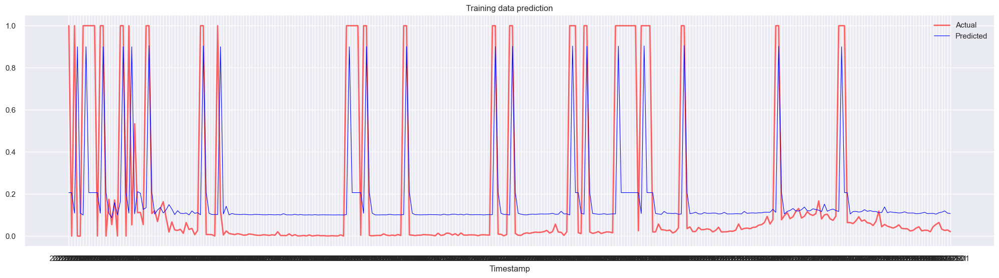

In [138]:
plt.figure(figsize=(25,6))
plt.plot(train_timestamps, y_train, color = 'red', linewidth=2.0, alpha = 0.6)
plt.plot(train_timestamps, y_train_pred, color = 'blue', linewidth=0.8)
plt.legend(['Actual','Predicted'])
plt.xlabel('Timestamp')
plt.title("Training data prediction")
plt.show()

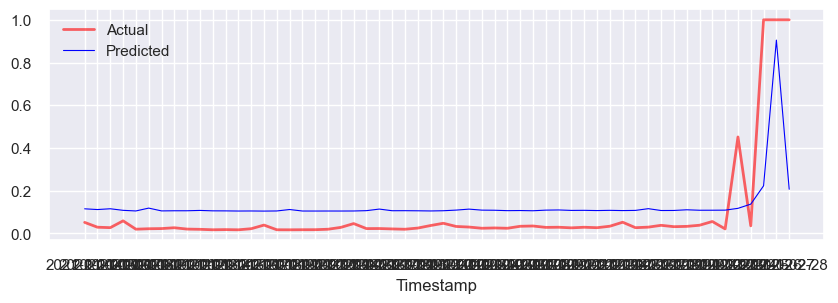

In [139]:
plt.figure(figsize=(10,3))
plt.plot(test_timestamps, y_test, color = 'red', linewidth=2.0, alpha = 0.6)
plt.plot(test_timestamps, y_test_pred, color = 'blue', linewidth=0.8)
plt.legend(['Actual','Predicted'])
plt.xlabel('Timestamp')
plt.show()